<a href="https://colab.research.google.com/github/raman1412/DESeq2/blob/main/AlphaFold2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://raw.githubusercontent.com/sokrypton/ColabFold/main/.github/ColabFold_Marv_Logo_Small.png" height="200" align="right" style="height:240px">

##ColabFold v1.5.5: AlphaFold2 using MMseqs2

Easy to use protein structure and complex prediction using [AlphaFold2](https://www.nature.com/articles/s41586-021-03819-2) and [Alphafold2-multimer](https://www.biorxiv.org/content/10.1101/2021.10.04.463034v1). Sequence alignments/templates are generated through [MMseqs2](mmseqs.com) and [HHsearch](https://github.com/soedinglab/hh-suite). For more details, see <a href="#Instructions">bottom</a> of the notebook, checkout the [ColabFold GitHub](https://github.com/sokrypton/ColabFold) and [Nature Protocols](https://www.nature.com/articles/s41596-024-01060-5).

Old versions: [v1.4](https://colab.research.google.com/github/sokrypton/ColabFold/blob/v1.4.0/AlphaFold2.ipynb), [v1.5.1](https://colab.research.google.com/github/sokrypton/ColabFold/blob/v1.5.1/AlphaFold2.ipynb), [v1.5.2](https://colab.research.google.com/github/sokrypton/ColabFold/blob/v1.5.2/AlphaFold2.ipynb), [v1.5.3-patch](https://colab.research.google.com/github/sokrypton/ColabFold/blob/56c72044c7d51a311ca99b953a71e552fdc042e1/AlphaFold2.ipynb)

[Mirdita M, Schütze K, Moriwaki Y, Heo L, Ovchinnikov S, Steinegger M. ColabFold: Making protein folding accessible to all.
*Nature Methods*, 2022](https://www.nature.com/articles/s41592-022-01488-1)

In [3]:
#@title Input protein sequence(s), then hit `Runtime` -> `Run all`
from google.colab import files
import os
import re
import hashlib
import random

from sys import version_info
python_version = f"{version_info.major}.{version_info.minor}"

def add_hash(x,y):
  return x+"_"+hashlib.sha1(y.encode()).hexdigest()[:5]

query_sequence = 'MGEKNGDAKTFWMELEDDGKVDFIFEQVQNVLQSLKQKIKDGSATNKEYIQAMILVNEATIINSSTSIKGASQKEVNAQSSDPMPVTQKEQENKSNAFPSTSCENSFPEDCTFLTTENKEILSLEDKVVDFREKDSSSNLSYQSHDCSGACLMKMPLNLKGENPLQLPIKCHFQRRHAKTNSHSSALHVSYKTPCGRSLRNVEEVFRYLLETECNFLFTDNFSFNTYVQLARNYPKQKEVVSDVDISNGVESVPISFCNEIDSRKLPQFKYRKTVWPRAYNLTNFSSMFTDSCDCSEGCIDITKCACLQLTARNAKTSPLSSDKITTGYKYKRLQRQIPTGIYECSLLCKCNRQLCQNRVVQHGPQVRLQVFKTEQKGWGVRCLDDIDRGTFVCIYSGRLLSRANTEKSYGIDENGRDENTMKNIFSKKRKLEVACSDCEVEVLPLGLETHPRTAKTEKCPPKFSNNPKELTVETKYDNISRIQYHSVIRDPESKTAIFQHNGKKMEFVSSESVTPEDNDGFKPPREHLNSKTKGAQKDSSSNHVDEFEDNLLIESDVIDITKYREETPPRSRCNQATTLDNQNIKKAIEVQIQKPQEGRSTACQRQQVFCDEELLSETKNTSSDSLTKFNKGNVFLLDATKEGNVGRFLNHSCCPNLLVQNVFVETHNRNFPLVAFFTNRYVKARTELTWDYGYEAGTVPEKEIFCQCGVNKCRKKIL' #@param {type:"string"}
#@markdown  - Use `:` to specify inter-protein chainbreaks for **modeling complexes** (supports homo- and hetro-oligomers). For example **PI...SK:PI...SK** for a homodimer
jobname = 'test' #@param {type:"string"}
# number of models to use
num_relax = 0 #@param [0, 1, 5] {type:"raw"}
#@markdown - specify how many of the top ranked structures to relax using amber
template_mode = "none" #@param ["none", "pdb100","custom"]
#@markdown - `none` = no template information is used. `pdb100` = detect templates in pdb100 (see [notes](#pdb100)). `custom` - upload and search own templates (PDB or mmCIF format, see [notes](#custom_templates))

use_amber = num_relax > 0

# remove whitespaces
query_sequence = "".join(query_sequence.split())

basejobname = "".join(jobname.split())
basejobname = re.sub(r'\W+', '', basejobname)
jobname = add_hash(basejobname, query_sequence)

# check if directory with jobname exists
def check(folder):
  if os.path.exists(folder):
    return False
  else:
    return True
if not check(jobname):
  n = 0
  while not check(f"{jobname}_{n}"): n += 1
  jobname = f"{jobname}_{n}"

# make directory to save results
os.makedirs(jobname, exist_ok=True)

# save queries
queries_path = os.path.join(jobname, f"{jobname}.csv")
with open(queries_path, "w") as text_file:
  text_file.write(f"id,sequence\n{jobname},{query_sequence}")

if template_mode == "pdb100":
  use_templates = True
  custom_template_path = None
elif template_mode == "custom":
  custom_template_path = os.path.join(jobname,f"template")
  os.makedirs(custom_template_path, exist_ok=True)
  uploaded = files.upload()
  use_templates = True
  for fn in uploaded.keys():
    os.rename(fn,os.path.join(custom_template_path,fn))
else:
  custom_template_path = None
  use_templates = False

print("jobname",jobname)
print("sequence",query_sequence)
print("length",len(query_sequence.replace(":","")))

jobname test_3a948
sequence MGEKNGDAKTFWMELEDDGKVDFIFEQVQNVLQSLKQKIKDGSATNKEYIQAMILVNEATIINSSTSIKGASQKEVNAQSSDPMPVTQKEQENKSNAFPSTSCENSFPEDCTFLTTENKEILSLEDKVVDFREKDSSSNLSYQSHDCSGACLMKMPLNLKGENPLQLPIKCHFQRRHAKTNSHSSALHVSYKTPCGRSLRNVEEVFRYLLETECNFLFTDNFSFNTYVQLARNYPKQKEVVSDVDISNGVESVPISFCNEIDSRKLPQFKYRKTVWPRAYNLTNFSSMFTDSCDCSEGCIDITKCACLQLTARNAKTSPLSSDKITTGYKYKRLQRQIPTGIYECSLLCKCNRQLCQNRVVQHGPQVRLQVFKTEQKGWGVRCLDDIDRGTFVCIYSGRLLSRANTEKSYGIDENGRDENTMKNIFSKKRKLEVACSDCEVEVLPLGLETHPRTAKTEKCPPKFSNNPKELTVETKYDNISRIQYHSVIRDPESKTAIFQHNGKKMEFVSSESVTPEDNDGFKPPREHLNSKTKGAQKDSSSNHVDEFEDNLLIESDVIDITKYREETPPRSRCNQATTLDNQNIKKAIEVQIQKPQEGRSTACQRQQVFCDEELLSETKNTSSDSLTKFNKGNVFLLDATKEGNVGRFLNHSCCPNLLVQNVFVETHNRNFPLVAFFTNRYVKARTELTWDYGYEAGTVPEKEIFCQCGVNKCRKKIL
length 719


In [4]:
#@title Install dependencies
%%time
import os
USE_AMBER = use_amber
USE_TEMPLATES = use_templates
PYTHON_VERSION = python_version

if not os.path.isfile("COLABFOLD_READY"):
  print("installing colabfold...")
  os.system("pip install -q --no-warn-conflicts 'colabfold[alphafold-minus-jax] @ git+https://github.com/sokrypton/ColabFold'")
  if os.environ.get('TPU_NAME', False) != False:
    os.system("pip uninstall -y jax jaxlib")
    os.system("pip install --no-warn-conflicts --upgrade dm-haiku==0.0.10 'jax[cuda12_pip]'==0.3.25 -f https://storage.googleapis.com/jax-releases/jax_cuda_releases.html")
  os.system("ln -s /usr/local/lib/python3.*/dist-packages/colabfold colabfold")
  os.system("ln -s /usr/local/lib/python3.*/dist-packages/alphafold alphafold")
  # hack to fix TF crash
  os.system("rm -f /usr/local/lib/python3.*/dist-packages/tensorflow/core/kernels/libtfkernel_sobol_op.so")
  os.system("touch COLABFOLD_READY")

if USE_AMBER or USE_TEMPLATES:
  if not os.path.isfile("CONDA_READY"):
    print("installing conda...")
    os.system("wget -qnc https://github.com/conda-forge/miniforge/releases/latest/download/Miniforge3-Linux-x86_64.sh")
    os.system("bash Miniforge3-Linux-x86_64.sh -bfp /usr/local")
    os.system("mamba config --set auto_update_conda false")
    os.system("touch CONDA_READY")

if USE_TEMPLATES and not os.path.isfile("HH_READY") and USE_AMBER and not os.path.isfile("AMBER_READY"):
  print("installing hhsuite and amber...")
  os.system(f"mamba install -y -c conda-forge -c bioconda kalign2=2.04 hhsuite=3.3.0 openmm=8.2.0 python='{PYTHON_VERSION}' pdbfixer")
  os.system("touch HH_READY")
  os.system("touch AMBER_READY")
else:
  if USE_TEMPLATES and not os.path.isfile("HH_READY"):
    print("installing hhsuite...")
    os.system(f"mamba install -y -c conda-forge -c bioconda kalign2=2.04 hhsuite=3.3.0 python='{PYTHON_VERSION}'")
    os.system("touch HH_READY")
  if USE_AMBER and not os.path.isfile("AMBER_READY"):
    print("installing amber...")
    os.system(f"mamba install -y -c conda-forge openmm=8.2.0 python='{PYTHON_VERSION}' pdbfixer")
    os.system("touch AMBER_READY")

CPU times: user 30 µs, sys: 0 ns, total: 30 µs
Wall time: 32.9 µs


In [5]:
#@markdown ### MSA options (custom MSA upload, single sequence, pairing mode)
msa_mode = "mmseqs2_uniref_env" #@param ["mmseqs2_uniref_env", "mmseqs2_uniref","single_sequence","custom"]
pair_mode = "unpaired_paired" #@param ["unpaired_paired","paired","unpaired"] {type:"string"}
#@markdown - "unpaired_paired" = pair sequences from same species + unpaired MSA, "unpaired" = seperate MSA for each chain, "paired" - only use paired sequences.

# decide which a3m to use
if "mmseqs2" in msa_mode:
  a3m_file = os.path.join(jobname,f"{jobname}.a3m")

elif msa_mode == "custom":
  a3m_file = os.path.join(jobname,f"{jobname}.custom.a3m")
  if not os.path.isfile(a3m_file):
    custom_msa_dict = files.upload()
    custom_msa = list(custom_msa_dict.keys())[0]
    header = 0
    import fileinput
    for line in fileinput.FileInput(custom_msa,inplace=1):
      if line.startswith(">"):
         header = header + 1
      if not line.rstrip():
        continue
      if line.startswith(">") == False and header == 1:
         query_sequence = line.rstrip()
      print(line, end='')

    os.rename(custom_msa, a3m_file)
    queries_path=a3m_file
    print(f"moving {custom_msa} to {a3m_file}")

else:
  a3m_file = os.path.join(jobname,f"{jobname}.single_sequence.a3m")
  with open(a3m_file, "w") as text_file:
    text_file.write(">1\n%s" % query_sequence)

In [6]:
#@markdown ### Advanced settings
model_type = "auto" #@param ["auto", "alphafold2_ptm", "alphafold2_multimer_v1", "alphafold2_multimer_v2", "alphafold2_multimer_v3", "deepfold_v1", "alphafold2"]
#@markdown - if `auto` selected, will use `alphafold2_ptm` for monomer prediction and `alphafold2_multimer_v3` for complex prediction.
#@markdown Any of the mode_types can be used (regardless if input is monomer or complex).
num_recycles = "3" #@param ["auto", "0", "1", "3", "6", "12", "24", "48"]
#@markdown - if `auto` selected, will use `num_recycles=20` if `model_type=alphafold2_multimer_v3`, else `num_recycles=3` .
recycle_early_stop_tolerance = "auto" #@param ["auto", "0.0", "0.5", "1.0"]
#@markdown - if `auto` selected, will use `tol=0.5` if `model_type=alphafold2_multimer_v3` else `tol=0.0`.
relax_max_iterations = 200 #@param [0, 200, 2000] {type:"raw"}
#@markdown - max amber relax iterations, `0` = unlimited (AlphaFold2 default, can take very long)
pairing_strategy = "greedy" #@param ["greedy", "complete"] {type:"string"}
#@markdown - `greedy` = pair any taxonomically matching subsets, `complete` = all sequences have to match in one line.
calc_extra_ptm = False #@param {type:"boolean"}
#@markdown - return pairwise chain iptm/actifptm

#@markdown #### Sample settings
#@markdown -  enable dropouts and increase number of seeds to sample predictions from uncertainty of the model.
#@markdown -  decrease `max_msa` to increase uncertainity
max_msa = "auto" #@param ["auto", "512:1024", "256:512", "64:128", "32:64", "16:32"]
num_seeds = 1 #@param [1,2,4,8,16] {type:"raw"}
use_dropout = False #@param {type:"boolean"}

num_recycles = None if num_recycles == "auto" else int(num_recycles)
recycle_early_stop_tolerance = None if recycle_early_stop_tolerance == "auto" else float(recycle_early_stop_tolerance)
if max_msa == "auto": max_msa = None

#@markdown #### Save settings
save_all = False #@param {type:"boolean"}
save_recycles = False #@param {type:"boolean"}
save_to_google_drive = False #@param {type:"boolean"}
#@markdown -  if the save_to_google_drive option was selected, the result zip will be uploaded to your Google Drive
dpi = 200 #@param {type:"integer"}
#@markdown - set dpi for image resolution

if save_to_google_drive:
  from pydrive2.drive import GoogleDrive
  from pydrive2.auth import GoogleAuth
  from google.colab import auth
  from oauth2client.client import GoogleCredentials
  auth.authenticate_user()
  gauth = GoogleAuth()
  gauth.credentials = GoogleCredentials.get_application_default()
  drive = GoogleDrive(gauth)
  print("You are logged into Google Drive and are good to go!")

#@markdown Don't forget to hit `Runtime` -> `Run all` after updating the form.

2025-11-06 04:55:26,256 Running on GPU
2025-11-06 04:55:26,595 Found 5 citations for tools or databases
2025-11-06 04:55:26,595 Query 1/1: test_3a948 (length 719)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-06 04:55:26,809 Sleeping for 7s. Reason: PENDING


RUNNING:   5%|▍         | 7/150 [elapsed: 00:07 remaining: 02:31]

2025-11-06 04:55:34,013 Sleeping for 8s. Reason: RUNNING


RUNNING:  10%|█         | 15/150 [elapsed: 00:15 remaining: 02:20]

2025-11-06 04:55:42,220 Sleeping for 6s. Reason: RUNNING


RUNNING:  14%|█▍        | 21/150 [elapsed: 00:21 remaining: 02:13]

2025-11-06 04:55:48,430 Sleeping for 8s. Reason: RUNNING


RUNNING:  19%|█▉        | 29/150 [elapsed: 00:30 remaining: 02:04]

2025-11-06 04:55:56,647 Sleeping for 6s. Reason: RUNNING


RUNNING:  23%|██▎       | 35/150 [elapsed: 00:36 remaining: 01:58]

2025-11-06 04:56:02,866 Sleeping for 7s. Reason: RUNNING


RUNNING:  28%|██▊       | 42/150 [elapsed: 00:43 remaining: 01:51]

2025-11-06 04:56:10,077 Sleeping for 10s. Reason: RUNNING


RUNNING:  35%|███▍      | 52/150 [elapsed: 00:53 remaining: 01:40]

2025-11-06 04:56:20,299 Sleeping for 7s. Reason: RUNNING


RUNNING:  39%|███▉      | 59/150 [elapsed: 01:00 remaining: 01:33]

2025-11-06 04:56:27,505 Sleeping for 6s. Reason: RUNNING


RUNNING:  43%|████▎     | 65/150 [elapsed: 01:07 remaining: 01:27]

2025-11-06 04:56:33,718 Sleeping for 7s. Reason: RUNNING


RUNNING:  48%|████▊     | 72/150 [elapsed: 01:14 remaining: 01:20]

2025-11-06 04:56:40,924 Sleeping for 5s. Reason: RUNNING


RUNNING:  51%|█████▏    | 77/150 [elapsed: 01:19 remaining: 01:15]

2025-11-06 04:56:46,132 Sleeping for 8s. Reason: RUNNING


RUNNING:  57%|█████▋    | 85/150 [elapsed: 01:27 remaining: 01:06]

2025-11-06 04:56:54,346 Sleeping for 9s. Reason: RUNNING


RUNNING:  63%|██████▎   | 94/150 [elapsed: 01:36 remaining: 00:57]

2025-11-06 04:57:03,553 Sleeping for 10s. Reason: RUNNING


RUNNING:  69%|██████▉   | 104/150 [elapsed: 01:47 remaining: 00:47]

2025-11-06 04:57:13,765 Sleeping for 10s. Reason: RUNNING


RUNNING:  76%|███████▌  | 114/150 [elapsed: 01:57 remaining: 00:36]

2025-11-06 04:57:23,977 Sleeping for 5s. Reason: RUNNING


COMPLETE: 100%|██████████| 150/150 [elapsed: 02:03 remaining: 00:00]


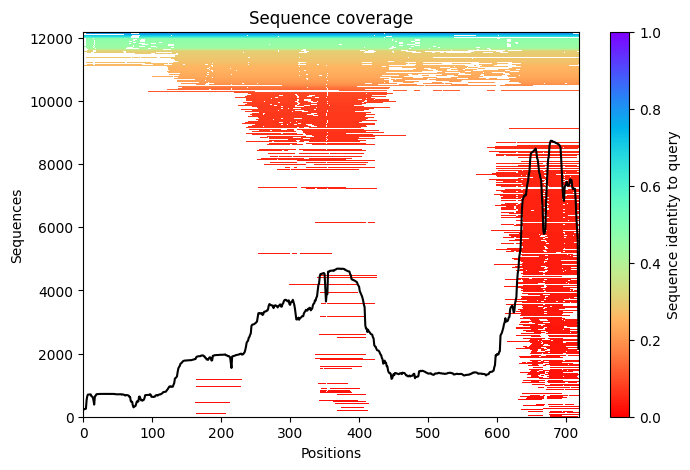

2025-11-06 04:57:36,304 Setting max_seq=512, max_extra_seq=5120
2025-11-06 05:00:44,532 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=61.2 pTM=0.573
2025-11-06 05:03:01,172 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=61.7 pTM=0.589 tol=9.08
2025-11-06 05:04:58,488 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=61.7 pTM=0.586 tol=6.01
2025-11-06 05:06:55,657 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=61.4 pTM=0.585 tol=3.7
2025-11-06 05:06:55,658 alphafold2_ptm_model_1_seed_000 took 529.3s (3 recycles)


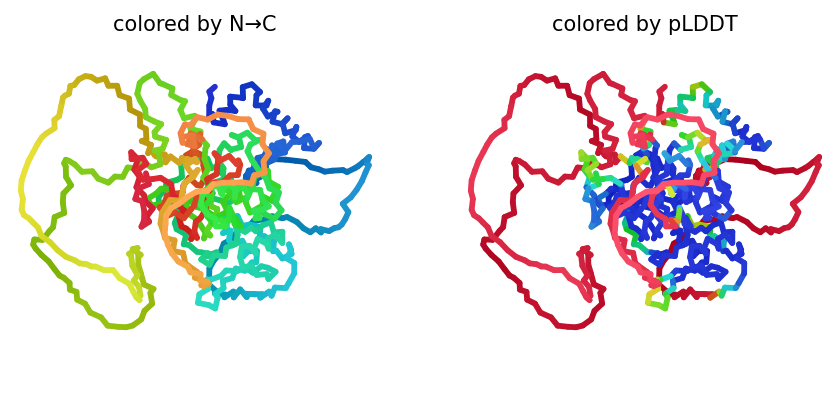

2025-11-06 05:08:53,662 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=61 pTM=0.562
2025-11-06 05:10:50,953 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=60.3 pTM=0.581 tol=8.97
2025-11-06 05:12:48,324 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.3 pTM=0.582 tol=2.77
2025-11-06 05:14:45,934 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=60.3 pTM=0.578 tol=1.22
2025-11-06 05:14:45,936 alphafold2_ptm_model_2_seed_000 took 469.5s (3 recycles)


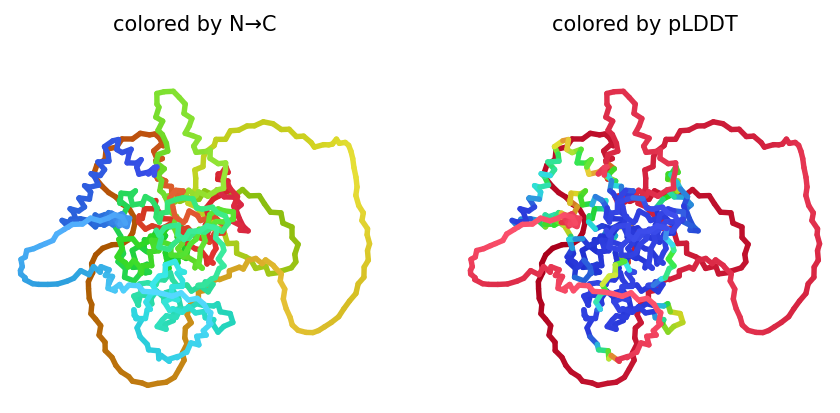

2025-11-06 05:16:44,424 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=62 pTM=0.562
2025-11-06 05:18:41,790 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=62.1 pTM=0.578 tol=11.5
2025-11-06 05:20:39,181 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=62.2 pTM=0.574 tol=6.64
2025-11-06 05:22:36,505 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=61.8 pTM=0.575 tol=5.04
2025-11-06 05:22:36,506 alphafold2_ptm_model_3_seed_000 took 469.4s (3 recycles)


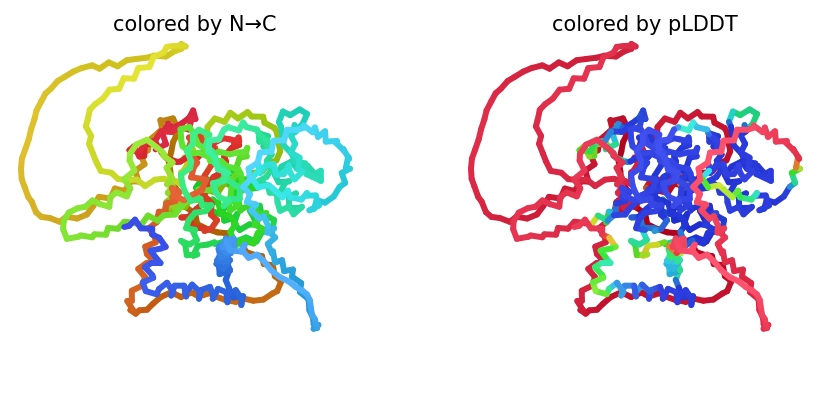

2025-11-06 05:24:34,823 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.7 pTM=0.572
2025-11-06 05:26:32,130 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=60.7 pTM=0.586 tol=9.34
2025-11-06 05:28:29,379 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=60.9 pTM=0.584 tol=6.76
2025-11-06 05:30:26,712 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=60.6 pTM=0.583 tol=6.88
2025-11-06 05:30:26,714 alphafold2_ptm_model_4_seed_000 took 469.2s (3 recycles)


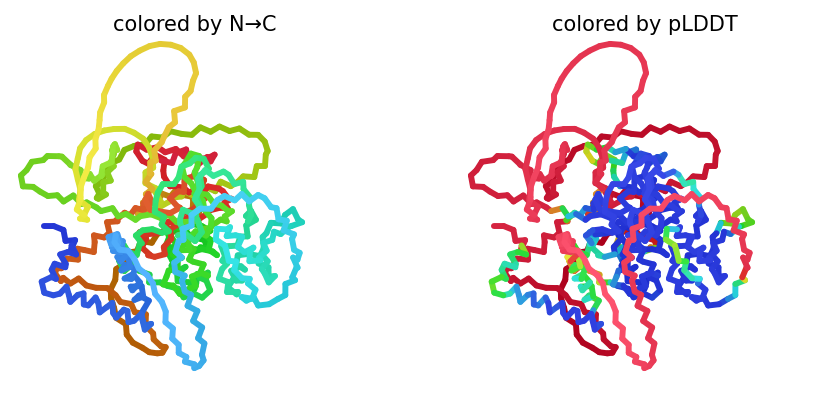

2025-11-06 05:32:25,119 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=60.9 pTM=0.582
2025-11-06 05:34:22,390 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=60.3 pTM=0.603 tol=7.42
2025-11-06 05:36:19,726 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=60.3 pTM=0.609 tol=3.67
2025-11-06 05:38:16,987 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=60.2 pTM=0.614 tol=2.25
2025-11-06 05:38:16,989 alphafold2_ptm_model_5_seed_000 took 469.2s (3 recycles)


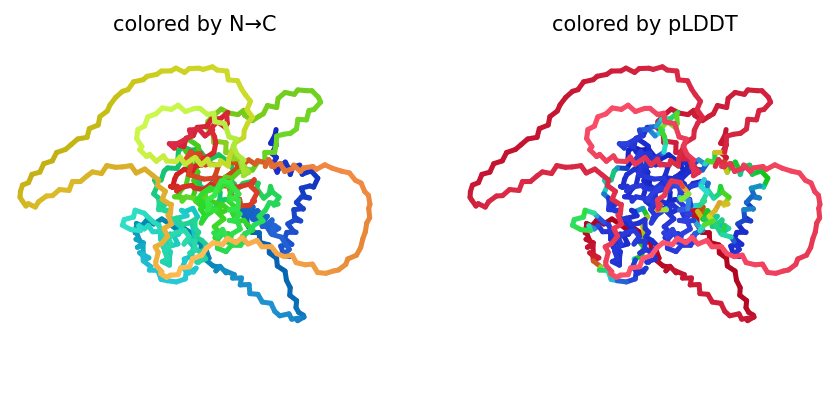

2025-11-06 05:38:17,884 reranking models by 'plddt' metric
2025-11-06 05:38:17,885 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=61.8 pTM=0.575
2025-11-06 05:38:17,885 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=61.4 pTM=0.585
2025-11-06 05:38:17,885 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=60.6 pTM=0.583
2025-11-06 05:38:17,886 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=60.3 pTM=0.578
2025-11-06 05:38:17,892 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=60.2 pTM=0.614
2025-11-06 05:38:20,925 Done


0

In [7]:
#@title Run Prediction
display_images = True #@param {type:"boolean"}

import sys
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
from Bio import BiopythonDeprecationWarning
warnings.simplefilter(action='ignore', category=BiopythonDeprecationWarning)
from pathlib import Path
from colabfold.download import download_alphafold_params, default_data_dir
from colabfold.utils import setup_logging
from colabfold.batch import get_queries, run, set_model_type
from colabfold.plot import plot_msa_v2

import os
import numpy as np
try:
  K80_chk = os.popen('nvidia-smi | grep "Tesla K80" | wc -l').read()
except:
  K80_chk = "0"
  pass
if "1" in K80_chk:
  print("WARNING: found GPU Tesla K80: limited to total length < 1000")
  if "TF_FORCE_UNIFIED_MEMORY" in os.environ:
    del os.environ["TF_FORCE_UNIFIED_MEMORY"]
  if "XLA_PYTHON_CLIENT_MEM_FRACTION" in os.environ:
    del os.environ["XLA_PYTHON_CLIENT_MEM_FRACTION"]

from colabfold.colabfold import plot_protein
from pathlib import Path
import matplotlib.pyplot as plt

# For some reason we need that to get pdbfixer to import
if use_amber and f"/usr/local/lib/python{python_version}/site-packages/" not in sys.path:
    sys.path.insert(0, f"/usr/local/lib/python{python_version}/site-packages/")

def input_features_callback(input_features):
  if display_images:
    plot_msa_v2(input_features)
    plt.show()
    plt.close()

def prediction_callback(protein_obj, length,
                        prediction_result, input_features, mode):
  model_name, relaxed = mode
  if not relaxed:
    if display_images:
      fig = plot_protein(protein_obj, Ls=length, dpi=150)
      plt.show()
      plt.close()

result_dir = jobname
log_filename = os.path.join(jobname,"log.txt")
setup_logging(Path(log_filename))

queries, is_complex = get_queries(queries_path)
model_type = set_model_type(is_complex, model_type)

if "multimer" in model_type and max_msa is not None:
  use_cluster_profile = False
else:
  use_cluster_profile = True

download_alphafold_params(model_type, Path("."))
results = run(
    queries=queries,
    result_dir=result_dir,
    use_templates=use_templates,
    custom_template_path=custom_template_path,
    num_relax=num_relax,
    msa_mode=msa_mode,
    model_type=model_type,
    num_models=5,
    num_recycles=num_recycles,
    relax_max_iterations=relax_max_iterations,
    recycle_early_stop_tolerance=recycle_early_stop_tolerance,
    num_seeds=num_seeds,
    use_dropout=use_dropout,
    model_order=[1,2,3,4,5],
    is_complex=is_complex,
    data_dir=Path("."),
    keep_existing_results=False,
    rank_by="auto",
    pair_mode=pair_mode,
    pairing_strategy=pairing_strategy,
    stop_at_score=float(100),
    prediction_callback=prediction_callback,
    dpi=dpi,
    zip_results=False,
    save_all=save_all,
    max_msa=max_msa,
    use_cluster_profile=use_cluster_profile,
    input_features_callback=input_features_callback,
    save_recycles=save_recycles,
    user_agent="colabfold/google-colab-main",
    calc_extra_ptm=calc_extra_ptm,
)
results_zip = f"{jobname}.result.zip"
os.system(f"zip -r {results_zip} {jobname}")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

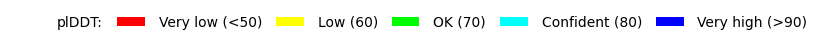

In [8]:
#@title Display 3D structure {run: "auto"}
import py3Dmol
import glob
import matplotlib.pyplot as plt
from colabfold.colabfold import plot_plddt_legend
from colabfold.colabfold import pymol_color_list, alphabet_list
rank_num = 1 #@param ["1", "2", "3", "4", "5"] {type:"raw"}
color = "lDDT" #@param ["chain", "lDDT", "rainbow"]
show_sidechains = False #@param {type:"boolean"}
show_mainchains = False #@param {type:"boolean"}

tag = results["rank"][0][rank_num - 1]
jobname_prefix = ".custom" if msa_mode == "custom" else ""
pdb_filename = f"{jobname}/{jobname}{jobname_prefix}_unrelaxed_{tag}.pdb"
pdb_file = glob.glob(pdb_filename)

def show_pdb(rank_num=1, show_sidechains=False, show_mainchains=False, color="lDDT"):
  model_name = f"rank_{rank_num}"
  view = py3Dmol.view(js='https://3dmol.org/build/3Dmol.js',)
  view.addModel(open(pdb_file[0],'r').read(),'pdb')

  if color == "lDDT":
    view.setStyle({'cartoon': {'colorscheme': {'prop':'b','gradient': 'roygb','min':50,'max':90}}})
  elif color == "rainbow":
    view.setStyle({'cartoon': {'color':'spectrum'}})
  elif color == "chain":
    chains = len(queries[0][1]) + 1 if is_complex else 1
    for n,chain,color in zip(range(chains),alphabet_list,pymol_color_list):
       view.setStyle({'chain':chain},{'cartoon': {'color':color}})

  if show_sidechains:
    BB = ['C','O','N']
    view.addStyle({'and':[{'resn':["GLY","PRO"],'invert':True},{'atom':BB,'invert':True}]},
                        {'stick':{'colorscheme':f"WhiteCarbon",'radius':0.3}})
    view.addStyle({'and':[{'resn':"GLY"},{'atom':'CA'}]},
                        {'sphere':{'colorscheme':f"WhiteCarbon",'radius':0.3}})
    view.addStyle({'and':[{'resn':"PRO"},{'atom':['C','O'],'invert':True}]},
                        {'stick':{'colorscheme':f"WhiteCarbon",'radius':0.3}})
  if show_mainchains:
    BB = ['C','O','N','CA']
    view.addStyle({'atom':BB},{'stick':{'colorscheme':f"WhiteCarbon",'radius':0.3}})

  view.zoomTo()
  return view

show_pdb(rank_num, show_sidechains, show_mainchains, color).show()
if color == "lDDT":
  plot_plddt_legend().show()


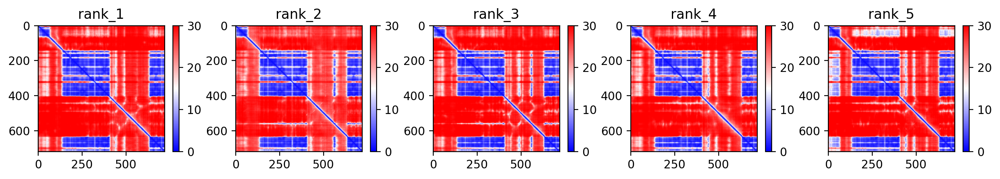
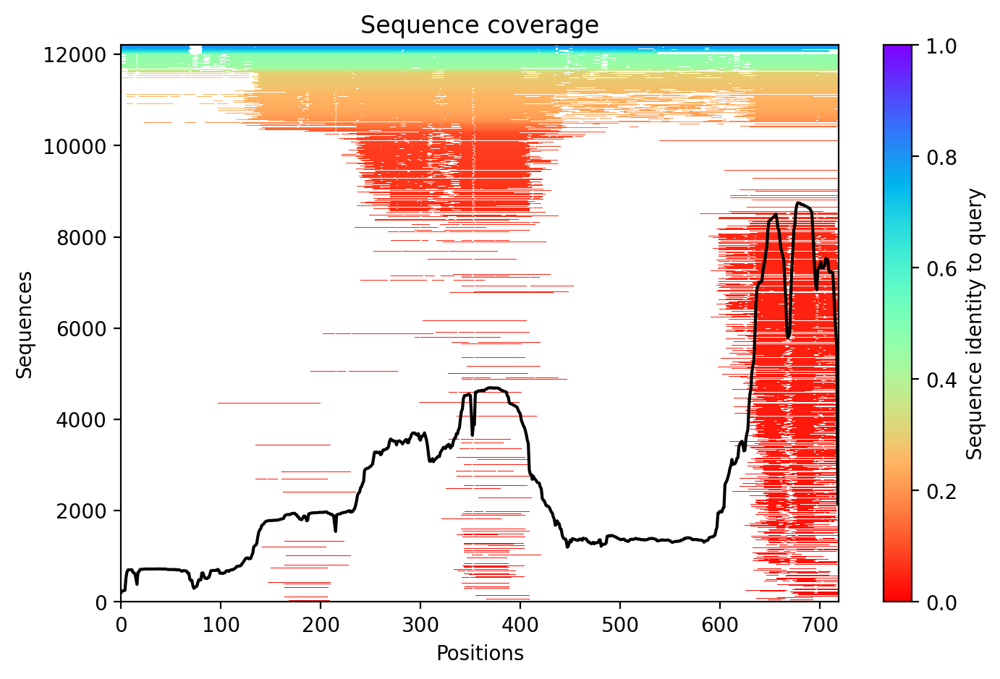
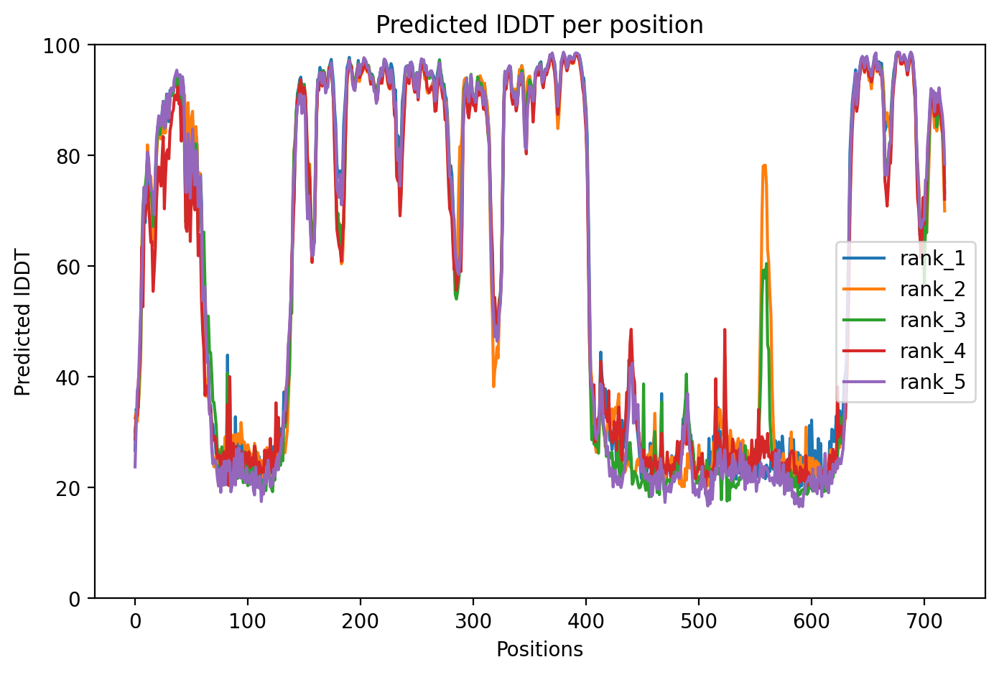

In [9]:
#@title Plots {run: "auto"}
from IPython.display import display, HTML
import base64
from html import escape

# see: https://stackoverflow.com/a/53688522
def image_to_data_url(filename):
  ext = filename.split('.')[-1]
  prefix = f'data:image/{ext};base64,'
  with open(filename, 'rb') as f:
    img = f.read()
  return prefix + base64.b64encode(img).decode('utf-8')

pae = ""
pae_file = os.path.join(jobname,f"{jobname}{jobname_prefix}_pae.png")
if os.path.isfile(pae_file):
    pae = image_to_data_url(pae_file)
cov = image_to_data_url(os.path.join(jobname,f"{jobname}{jobname_prefix}_coverage.png"))
plddt = image_to_data_url(os.path.join(jobname,f"{jobname}{jobname_prefix}_plddt.png"))
display(HTML(f"""
<style>
  img {{
    float:left;
  }}
  .full {{
    max-width:100%;
  }}
  .half {{
    max-width:50%;
  }}
  @media (max-width:640px) {{
    .half {{
      max-width:100%;
    }}
  }}
</style>
<div style="max-width:90%; padding:2em;">
  <h1>Plots for {escape(jobname)}</h1>
  { '<!--' if pae == '' else '' }<img src="{pae}" class="full" />{ '-->' if pae == '' else '' }
  <img src="{cov}" class="half" />
  <img src="{plddt}" class="half" />
</div>
"""))

In [10]:
#@title Package and download results
#@markdown If you are having issues downloading the result archive, try disabling your adblocker and run this cell again. If that fails click on the little folder icon to the left, navigate to file: `jobname.result.zip`, right-click and select \"Download\" (see [screenshot](https://pbs.twimg.com/media/E6wRW2lWUAEOuoe?format=jpg&name=small)).

if msa_mode == "custom":
  print("Don't forget to cite your custom MSA generation method.")

files.download(f"{jobname}.result.zip")

if save_to_google_drive == True and drive:
  uploaded = drive.CreateFile({'title': f"{jobname}.result.zip"})
  uploaded.SetContentFile(f"{jobname}.result.zip")
  uploaded.Upload()
  print(f"Uploaded {jobname}.result.zip to Google Drive with ID {uploaded.get('id')}")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [11]:
# Chemistry + docking + utils
!apt-get -y update && apt-get -y install autodock-vina fpocket
!pip -q install rdkit-pypi openbabel-wrapper meeko pubchempy biopython py3Dmol prody matplotlib pandas
import pathlib, os, numpy as np, matplotlib.pyplot as plt
root = pathlib.Path("SETDB2_free"); (root/"figures").mkdir(parents=True, exist_ok=True)
print("OK")


Get:1 https://cli.github.com/packages stable InRelease [3,917 B]
Get:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:4 https://cli.github.com/packages stable/main amd64 Packages [344 B]
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:7 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:8 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [2,103 kB]
Get:9 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:10 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,820 kB]
Hit:11 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:12 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:13 http://archive.ubuntu.com/ubuntu jammy-backports InRe

In [13]:
# Minimal, working toolchain (no RDKit, no fpocket)
!apt-get -y update
!apt-get -y install autodock-vina

# Python packages that have wheels on Colab Py3.12
!pip -q install meeko pubchempy biopython py3Dmol prody matplotlib pandas

# sanity check
import subprocess, sys
print("Python:", sys.version)
subprocess.run(["vina", "--help"], check=False)
import py3Dmol, prody
print("py3Dmol OK, ProDy OK")

Hit:1 https://cli.github.com/packages stable InRelease
Hit:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:4 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:5 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Hit:6 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:7 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:10 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Reading packag

In [14]:
!apt-get -y install openbabel


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libinchi1 libmaeparser1 libopenbabel7
The following NEW packages will be installed:
  libinchi1 libmaeparser1 libopenbabel7 openbabel
0 upgraded, 4 newly installed, 0 to remove and 47 not upgraded.
Need to get 3,903 kB of archives.
After this operation, 16.9 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libinchi1 amd64 1.03+dfsg-4 [455 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libmaeparser1 amd64 1.2.4-1build1 [88.2 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libopenbabel7 amd64 3.1.1+dfsg-6ubuntu5 [3,231 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy/universe amd64 openbabel amd64 3.1.1+dfsg-6ubuntu5 [128 kB]
Fetched 3,903 kB in 2s (2,370 kB/s)
Selecting previously unselected package libinchi1.
(Reading database ... 125094 files and dire

Saving test_3a948_unrelaxed_rank_001_alphafold2_ptm_model_3_seed_000.pdb to test_3a948_unrelaxed_rank_001_alphafold2_ptm_model_3_seed_000.pdb
Loaded: test_3a948_unrelaxed_rank_001_alphafold2_ptm_model_3_seed_000.pdb


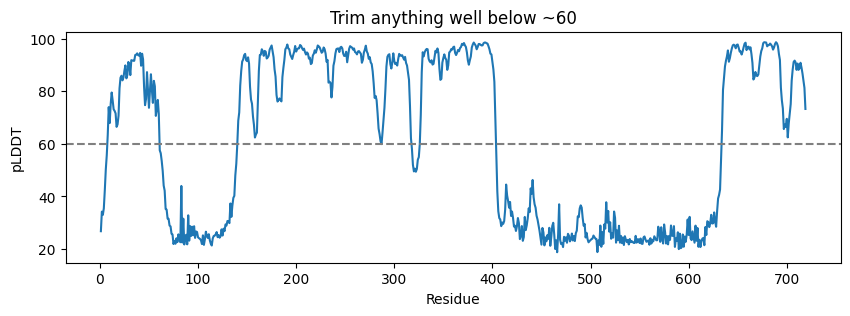

In [16]:
from google.colab import files
up = files.upload()   # pick ranked_0.pdb (or your favorite)
af_pdb = list(up.keys())[0]; print("Loaded:", af_pdb)

import numpy as np, matplotlib.pyplot as plt
from Bio.PDB import PDBParser
p = PDBParser(QUIET=True).get_structure("af", af_pdb)
vals=[]
for r in p.get_residues():
    if r.id[0] != ' ': continue
    b = np.mean([a.get_bfactor() for a in r if a.element!='H'])
    vals.append((r.id[1], b))
idx, bfac = zip(*vals)
plt.figure(figsize=(10,3))
plt.plot(idx, bfac); plt.axhline(60, ls='--', c='gray')
plt.xlabel("Residue"); plt.ylabel("pLDDT"); plt.title("Trim anything well below ~60")
plt.show()


In [17]:
import glob, shutil
src = sorted([p for p in glob.glob("*rank_001_*.pdb")])[0]
shutil.copy(src, "SETDB2_AF.pdb")
print("Using:", src, "→ SETDB2_AF.pdb")


Using: test_3a948_unrelaxed_rank_001_alphafold2_ptm_model_3_seed_000.pdb → SETDB2_AF.pdb


In [18]:
import glob, shutil
src = sorted([p for p in glob.glob("*rank_001_*.pdb")])[0]
shutil.copy(src, "SETDB2_AF.pdb")
print("Using:", src, "→ SETDB2_AF.pdb")


Using: test_3a948_unrelaxed_rank_001_alphafold2_ptm_model_3_seed_000.pdb → SETDB2_AF.pdb


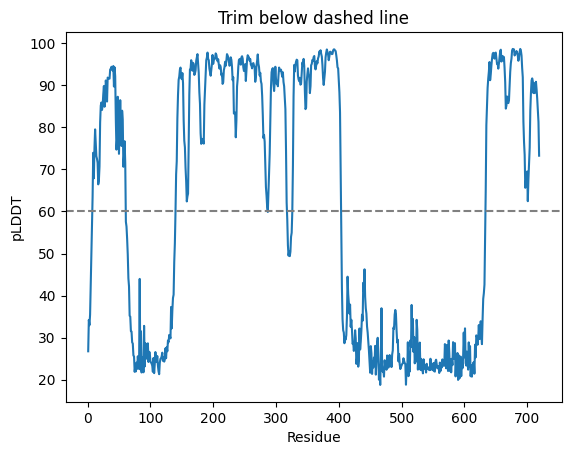

Saved: SETDB2_trimA.pdb, SETDB2_trimB.pdb


In [19]:
# Plot pLDDT to decide trims
import numpy as np, matplotlib.pyplot as plt
from Bio.PDB import PDBParser, PDBIO, Select
p = PDBParser(QUIET=True).get_structure("af", "SETDB2_AF.pdb")
vals=[]
for r in p.get_residues():
    if r.id[0] != ' ': continue
    b = np.mean([a.get_bfactor() for a in r if a.element!='H'])
    vals.append((r.id[1], b))
idx, bfac = zip(*vals)
plt.plot(idx, bfac); plt.axhline(60, ls='--', c='gray')
plt.xlabel("Residue"); plt.ylabel("pLDDT"); plt.title("Trim below dashed line"); plt.show()

# EDIT these after eyeballing the plot:
REMOVE_RANGES_A = [(1,60)]   # stricter trim
REMOVE_RANGES_B = [(1,30)]   # gentler trim

def trim_pdb(in_pdb, out_pdb, remove_ranges):
    class Keep(Select):
        def accept_residue(self, residue):
            if residue.id[0] != ' ': return 0
            i = residue.id[1]
            return 0 if any(a<=i<=b for a,b in remove_ranges) else 1
    io = PDBIO(); io.set_structure(PDBParser(QUIET=True).get_structure("x", in_pdb))
    io.save(out_pdb, select=Keep())

trim_pdb("SETDB2_AF.pdb","SETDB2_trimA.pdb",REMOVE_RANGES_A)
trim_pdb("SETDB2_AF.pdb","SETDB2_trimB.pdb",REMOVE_RANGES_B)
print("Saved: SETDB2_trimA.pdb, SETDB2_trimB.pdb")


In [24]:
# --- Robust SAM placement from 4IJ8 (handles multi-chain holo) ---
from prody import parsePDB, matchAlign, applyTransformation, writePDB
from collections import Counter

target_pdb = "SETDB2_trimA.pdb"  # change to SETDB2_AF.pdb if you didn't trim
holo_pdb   = "4IJ8.pdb"          # or whatever you uploaded (ensure it's in the cwd)

# 1) Read structures
tgt  = parsePDB(target_pdb)
holo = parsePDB(holo_pdb)

# 2) Find the chain that contains SAM in the holo
sam_atoms = holo.select('hetero and resname SAM')
assert sam_atoms is not None and sam_atoms.numAtoms()>0, "No SAM (resname SAM) in holo."
sam_chain_ids = [a.getChid() for a in sam_atoms]
sam_chain = Counter(sam_chain_ids).most_common(1)[0][0]

# 3) Build selections: only protein CA from the SAM chain vs your whole target chain
mobCA = holo.select(f'protein and chain {sam_chain} and name CA')
tarCA = tgt.select('protein and name CA')
assert mobCA is not None and tarCA is not None, "Failed to select CA atoms."

# 4) Sequence-aware matching + alignment (auto-matches subsets)
# matchAlign returns: transformation, mobileMatch, targetMatch, (rmsd)
out = matchAlign(mobCA, tarCA)

# 5) Apply transform to the whole holo, then extract SAM and merge
if out is not None:
    if len(out) == 4:
        T, mobMatch, tarMatch, rmsd = out
    else:
        T, mobMatch, tarMatch = out; rmsd = None

    holo.setCoords(applyTransformation(T, holo.getCoords()))
    sam = holo.select(f'hetero and resname SAM and chain {sam_chain}')
    assert sam is not None and sam.numAtoms()>10, "SAM selection after alignment failed."

    writePDB("_tmp_SAM.pdb", sam)

    # 6) Merge SAM into your target model
    prot_lines = [l for l in open(target_pdb) if l.startswith(("ATOM","TER","END"))]
    sam_lines  = [l for l in open("_tmp_SAM.pdb")    if l.startswith(("HETATM","ATOM  "))]
    open("SETDB2_trimA_SAMguess.pdb","w").write("".join(prot_lines + sam_lines + ["END\n"]))

    print("Placed SAM → SETDB2_trimA_SAMguess.pdb",
          "| matched CA:", mobMatch.numAtoms(), "RMSD:", rmsd)
else:
    print("matchAlign failed: Could not align the structures. Check sequence similarity and overlap between the selected chain in 4IJ8.pdb and SETDB2_trimA.pdb")

@> 5258 atoms and 1 coordinate set(s) were parsed in 0.06s.
@> 2646 atoms and 1 coordinate set(s) were parsed in 0.06s.
@> Checking AtomGroup 4IJ8: 1 chains are identified
@> Checking AtomGroup SETDB2_trimA: 1 chains are identified
@> Trying to match chains based on residue numbers and names:
@>   Comparing Chain A from 4IJ8 (len=161) and Chain A from SETDB2_trimA (len=659):
@> 	Failed to match chains (seqid=6%, overlap=24%).
@> Trying to match chains based on local sequence alignment:
@>  Comparing Chain A from 4IJ8 (len=161) and Chain A from SETDB2_trimA (len=659):
@> 	Failed to match chains (seqid=35%, overlap=22%).


2025-11-06 06:09:33,164 5258 atoms and 1 coordinate set(s) were parsed in 0.06s.
2025-11-06 06:09:33,224 2646 atoms and 1 coordinate set(s) were parsed in 0.06s.
2025-11-06 06:09:33,292 Checking AtomGroup 4IJ8: 1 chains are identified
2025-11-06 06:09:33,346 Checking AtomGroup SETDB2_trimA: 1 chains are identified
2025-11-06 06:09:33,347 Trying to match chains based on residue numbers and names:
2025-11-06 06:09:33,348   Comparing Chain A from 4IJ8 (len=161) and Chain A from SETDB2_trimA (len=659):
2025-11-06 06:09:33,349 	Failed to match chains (seqid=6%, overlap=24%).
2025-11-06 06:09:33,350 Trying to match chains based on local sequence alignment:
2025-11-06 06:09:33,350  Comparing Chain A from 4IJ8 (len=161) and Chain A from SETDB2_trimA (len=659):
2025-11-06 06:09:33,358 	Failed to match chains (seqid=35%, overlap=22%).
matchAlign failed: Could not align the structures. Check sequence similarity and overlap between the selected chain in 4IJ8.pdb and SETDB2_trimA.pdb


In [30]:
from Bio.PDB import PDBParser

holo_pdb = "4IJ8.pdb"
parser = PDBParser(QUIET=True)
structure = parser.get_structure("holo", holo_pdb)

hetero_residues = set()
for model in structure:
    for chain in model:
        for residue in chain:
            if residue.id[0] != ' ': # Check if it's a hetero atom residue
                hetero_residues.add(residue.get_resname())

print(f"Hetero residues found in {holo_pdb}:")
for resname in hetero_residues:
    print(resname)

Hetero residues found in 4IJ8.pdb:
HOH
UNX
SAM


In [38]:
from Bio.PDB import PDBParser

holo_pdb = "6BHD.pdb"  # Assuming the uploaded file was renamed or is accessible as 6BHD.pdb
parser = PDBParser(QUIET=True)
structure = parser.get_structure("holo", holo_pdb)

hetero_residues = set()
for model in structure:
    for chain in model:
        for residue in chain:
            if residue.id[0] != ' ': # Check if it's a hetero atom residue
                hetero_residues.add(residue.get_resname())

print(f"Hetero residues found in {holo_pdb}:")
for resname in hetero_residues:
    print(resname)

Hetero residues found in 6BHD.pdb:
MLY
HOH
UNX
ALY
NA


target_pdb = SETDB2_trimA.pdb | holo_pdb = 5J1Y.pdb


In [45]:
# === Read paths → place SAM → prep → dock SAM/SAH → export poses ===
# 0) read paths chosen by the fixer
with open("_paths.txt") as f:
    target_pdb = f.readline().strip()   # SETDB2_trimA.pdb or SETDB2_AF.pdb
    holo_pdb   = f.readline().strip()   # 5JIY.pdb (or similar)
print("target_pdb =", target_pdb, "| holo_pdb =", holo_pdb)

# 1) sequence-guided superposition, then copy SAM
from Bio.PDB import PDBParser, Superimposer, PDBIO, Select
from Bio.PDB.Polypeptide import PPBuilder # Handle conversion manually
# from Bio.PDB.Polypeptide import PPBuilder, three_to_one # Original import
# from Bio import pairwise2 # Imported later
import numpy as np, os, re, subprocess
from pathlib import Path
from Bio import pairwise2 # Import pairwise2 here


parser = PDBParser(QUIET=True)
tgt  = parser.get_structure("tgt",  target_pdb)
holo = parser.get_structure("holo", holo_pdb)

# find chain in holo that has SAM
sam_atoms = [a for a in holo.get_atoms()
             if a.get_parent().id[0]=='H' and a.get_parent().get_resname()=='SAM']
assert sam_atoms, f"No SAM found in {holo_pdb}. Pick a SAM/SAH holo (e.g., 5JIY/5JJ0)."
sam_chain_id = list({a.get_parent().get_parent().id for a in sam_atoms})[0]
holo_chain   = [c for c in holo.get_chains() if c.id == sam_chain_id][0]
tgt_chain    = [c for c in tgt.get_chains()][0]

# --- build sequences and residue lists (skip non-standard residues) ---
def chain_seq_and_reslist(chain):
    # Manual dictionary for three-to-one amino acid conversion
    three_to_one_dict = {
        'ALA': 'A', 'ARG': 'R', 'ASN': 'N', 'ASP': 'D', 'CYS': 'C',
        'GLN': 'Q', 'GLU': 'E', 'GLY': 'G', 'HIS': 'H', 'ILE': 'I',
        'LEU': 'L', 'LYS': 'K', 'MET': 'M', 'PHE': 'F', 'PRO': 'P',
        'SER': 'S', 'THR': 'T', 'TRP': 'W', 'TYR': 'Y', 'VAL': 'V'
    }
    ppb = PPBuilder(); seq=""; res=[]
    for pp in ppb.build_peptides(chain):
        for r in pp:
            try:
                aa = three_to_one_dict[r.get_resname()] # Manual conversion
            except KeyError:
                continue
            seq += aa; res.append(r)
    return seq, res

seq_t, res_t = chain_seq_and_reslist(tgt_chain)
seq_h, res_h = chain_seq_and_reslist(holo_chain)
assert seq_t and seq_h, "Empty sequences from PDBs."

aln = pairwise2.align.globalms(seq_h, seq_t, 2, -1, -5, -0.5, one_alignment_only=True)[0]
al_h, al_t = aln.seqA, aln.seqB

coords_h, coords_t = [], []
ih = it = 0
for a_h, a_t in zip(al_h, al_t):
    resH = res_h[ih] if a_h!='-' else None; ih += (a_h!='-')
    resT = res_t[it] if a_t!='-' else None; it += (a_t!='-')
    if resH and resT and resH.has_id("CA") and resT.has_id("CA"):
        coords_h.append(resH["CA"].get_coord()); coords_t.append(resT["CA"].get_coord())

coords_h = np.array(coords_h); coords_t = np.array(coords_t)
assert len(coords_h) >= 40, f"Too few matched positions ({len(coords_h)}). Use a closer holo (G9a/SUV39)."

sup = Superimposer()
sup.set_atoms(coords_t, coords_h)   # target first, then mobile
rot, tran = sup.rotran
for atom in holo.get_atoms():
    atom.transform(rot, tran)

# extract transformed SAM and merge
sam_res = [a.get_parent() for a in holo.get_atoms()
           if a.get_parent().id[0]=='H' and a.get_parent().get_resname()=='SAM'][0]

class KeepSAM(Select):
    def accept_residue(self, residue): return residue is sam_res

io = PDBIO(); io.set_structure(sam_res.get_parent().get_parent())
io.save("_tmp_SAM.pdb", select=KeepSAM)

merged_pdb = "SETDB2_SAMguess.pdb"
prot_lines = [l for l in open(target_pdb) if l.startswith(("ATOM","TER","END"))]
sam_lines  = [l for l in open("_tmp_SAM.pdb") if l.startswith(("HETATM","ATOM  "))]
open(merged_pdb,"w").write("".join(prot_lines + sam_lines + ["END\n"]))
print(f"SAM placed → {merged_pdb} | RMSD: {sup.rms:.2f} Å on {len(coords_h)} Cα")

# 2) prepare receptor (protein +H) → PDBQT
!obabel -ipdb {target_pdb} -opdb -O receptorH.pdb --addhydrogens
!obabel -ipdb receptorH.pdb -opdbqt -O receptor.pdbqt

# 3) get SAM & SAH ligands and prep PDBQT
import pubchempy as pcp, pathlib
for nm, tag in [("S-adenosyl-L-methionine","SAM"), ("S-adenosyl-L-homocysteine","SAH")]:
    pathlib.Path(f"{tag}.sdf").write_text(pcp.get_compounds(nm,'name')[0].to_sdf())
    !obabel -isdf {tag}.sdf -opdbqt -O {tag}.pdbqt --gen3d

# 4) docking box from placed SAM atoms
xs,ys,zs=[],[],[]
for l in open(merged_pdb):
    if l.startswith("HETATM") and " SAM" in l:
        xs.append(float(l[30:38])); ys.append(float(l[38:46])); zs.append(float(l[46:54]))
cx,cy,cz = sum(xs)/len(xs), sum(ys)/len(ys), sum(zs)/len(zs)
box=(24,24,24)
print("Dock center:", (cx,cy,cz), "box:", box)

# 5) dock SAM/SAH (Vina)
def dock(lig, tag):
    out=f"{tag}_out.pdbqt"; log=f"{tag}.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",lig,
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(box[0]),"--size_y",str(box[1]),"--size_z",str(box[2]),
         "--exhaustiveness","16","--num_modes","20","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    score=None
    with open(log) as f:
        for line in f:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return out, score

sam_out, sam_score = dock("SAM.pdbqt","SAM")
sah_out, sah_score = dock("SAH.pdbqt","SAH")
print("Vina scores (kcal/mol)  SAM:", sam_score, " | SAH:", sah_score)

# 6) convert poses to PDB for viewing / figures
!obabel -ipdbqt SAM_out.pdbqt -opdb -O SAM_out.pdb
!obabel -ipdbqt SAH_out.pdbqt -opdb -O SAH_out.pdb

print("\n➡ Files ready for download:")
for f in [merged_pdb,"SAM_out.pdb","SAH_out.pdb","SAM.log","SAH.log"]:
    if Path(f).exists(): print("  ", f)

target_pdb = SETDB2_trimA.pdb | holo_pdb = 5J1Y.pdb


AssertionError: No SAM found in 5J1Y.pdb. Pick a SAM/SAH holo (e.g., 5JIY/5JJ0).

In [47]:
from Bio.PDB import PDBParser

holo_pdb = "5J1Y.pdb"  # Assuming the file is accessible as 5J1Y.pdb
parser = PDBParser(QUIET=True)
structure = parser.get_structure("holo", holo_pdb)

hetero_residues = set()
for model in structure:
    for chain in model:
        for residue in chain:
            if residue.id[0] != ' ': # Check if it's a hetero atom residue
                hetero_residues.add(residue.get_resname())

print(f"Hetero residues found in {holo_pdb}:")
for resname in hetero_residues:
    print(resname)

Hetero residues found in 5J1Y.pdb:
HOH
P87


In [49]:
# OLD
# from Bio.PDB.Polypeptide import PPBuilder, three_to_one
# NEW
from Bio.PDB.Polypeptide import PPBuilder
from Bio.SeqUtils import seq1


In [50]:
def chain_seq_and_reslist(chain):
    ppb = PPBuilder()
    seq, reslist = "", []
    for pp in ppb.build_peptides(chain):
        for res in pp:
            resname = res.get_resname().strip()
            try:
                # map 3-letter→1-letter; allow a few frequent mods
                aa = seq1(resname, custom_map={"MSE":"M","MLY":"K","ALY":"K","SEC":"U","PYL":"O"})
            except Exception:
                continue  # skip weird/unknown residues
            seq += aa
            reslist.append(res)
    return seq, reslist


In [51]:
# === Read paths → place SAM/SAH → prep → dock → export poses (Biopython seq1 fix) ===
# 0) read paths chosen by the fixer
with open("_paths.txt") as f:
    target_pdb = f.readline().strip()   # SETDB2_trimA.pdb or SETDB2_AF.pdb
    holo_pdb   = f.readline().strip()   # 5JIY.pdb (or similar)
print("target_pdb =", target_pdb, "| holo_pdb =", holo_pdb)

from pathlib import Path
import os, re, subprocess
import numpy as np
from Bio.PDB import PDBParser, Superimposer, PDBIO, Select
from Bio.PDB.Polypeptide import PPBuilder
from Bio.SeqUtils import seq1
from Bio import pairwise2

parser = PDBParser(QUIET=True)
tgt  = parser.get_structure("tgt",  target_pdb)

# If holo has no SAM/SAH, auto-fallback to 5JJ0 (G9a + SAH)
def file_has_ligand(pdb_path, code):
    s = parser.get_structure("tmp", pdb_path)
    for a in s.get_atoms():
        if a.get_parent().id[0]=='H' and a.get_parent().get_resname()==code:
            return True
    return False

if not Path(holo_pdb).exists():
    raise FileNotFoundError(f"{holo_pdb} not found. Re-run the path fixer or upload the holo.")

# Ensure we have a holo with SAM or SAH
if not (file_has_ligand(holo_pdb,"SAM") or file_has_ligand(holo_pdb,"SAH")):
    print(f"No SAM/SAH in {holo_pdb} → fetching 5JJ0.pdb (G9a+SAH) …")
    !wget -q -O 5JJ0.pdb https://files.rcsb.org/download/5JJ0.pdb
    holo_pdb = "5JJ0.pdb"

holo = parser.get_structure("holo", holo_pdb)

# Pick ligand preference: SAM if present, else SAH
lig_code = "SAM" if file_has_ligand(holo_pdb,"SAM") else "SAH"
print("Using ligand:", lig_code)

# --- helpers ---
def chain_seq_and_reslist(chain):
    ppb = PPBuilder()
    seq, reslist = "", []
    for pp in ppb.build_peptides(chain):
        for res in pp:
            resname = res.get_resname().strip()
            try:
                # map 3→1; allow common mods
                aa = seq1(resname, custom_map={"MSE":"M","MLY":"K","ALY":"K","SEC":"U","PYL":"O"})
            except Exception:
                continue
            seq += aa
            reslist.append(res)
    return seq, reslist

# choose chains: target first protein chain; holo chain that contains the ligand
tgt_chain  = [c for c in tgt.get_chains()][0]
lig_atoms  = [a for a in holo.get_atoms()
              if a.get_parent().id[0]=='H' and a.get_parent().get_resname()==lig_code]
assert lig_atoms, f"{lig_code} not found in {holo_pdb}."
lig_chain_id = list({a.get_parent().get_parent().id for a in lig_atoms})[0]
holo_chain = [c for c in holo.get_chains() if c.id == lig_chain_id][0]

# sequences for alignment
seq_t, res_t = chain_seq_and_reslist(tgt_chain)
seq_h, res_h = chain_seq_and_reslist(holo_chain)
assert seq_t and seq_h, "Empty sequences extracted from PDBs."

# global alignment + matched Cα lists
aln = pairwise2.align.globalms(seq_h, seq_t, 2, -1, -5, -0.5, one_alignment_only=True)[0]
al_h, al_t = aln.seqA, aln.seqB

coords_h, coords_t = [], []
ih = it = 0
for a_h, a_t in zip(al_h, al_t):
    resH = res_h[ih] if a_h!='-' else None; ih += (a_h!='-')
    resT = res_t[it] if a_t!='-' else None; it += (a_t!='-')
    if resH and resT and resH.has_id("CA") and resT.has_id("CA"):
        coords_h.append(resH["CA"].get_coord()); coords_t.append(resT["CA"].get_coord())

coords_h = np.array(coords_h); coords_t = np.array(coords_t)
assert len(coords_h) >= 40, f"Too few matched positions ({len(coords_h)}). Try a closer holo (SUV39/G9a SAH)."

# superpose holo→target using matched Cα
from Bio.PDB import Superimposer
sup = Superimposer()
sup.set_atoms(coords_t, coords_h)  # target first, then mobile
rot, tran = sup.rotran
for atom in holo.get_atoms():
    atom.transform(rot, tran)

# extract transformed ligand and merge into target
lig_res = [a.get_parent() for a in holo.get_atoms()
           if a.get_parent().id[0]=='H' and a.get_parent().get_resname()==lig_code][0]

class KeepLig(Select):
    def accept_residue(self, residue): return residue is lig_res

io = PDBIO(); io.set_structure(lig_res.get_parent().get_parent())
io.save("_tmp_LIG.pdb", select=KeepLig)

merged_pdb = "SETDB2_LIGguess.pdb"
prot_lines = [l for l in open(target_pdb) if l.startswith(("ATOM","TER","END"))]
lig_lines  = [l for l in open("_tmp_LIG.pdb") if l.startswith(("HETATM","ATOM  "))]
open(merged_pdb,"w").write("".join(prot_lines + lig_lines + ["END\n"]))
print(f"Placed {lig_code} → {merged_pdb} | RMSD: {sup.rms:.2f} Å on {len(coords_h)} Cα")

# === Docking prep ===
# receptor (protein +H) → PDBQT
!obabel -ipdb {target_pdb} -opdb -O receptorH.pdb --addhydrogens
!obabel -ipdb receptorH.pdb -opdbqt -O receptor.pdbqt

# ligands: fetch SAM & SAH and prep PDBQT
import pubchempy as pcp, pathlib
for nm, tag in [("S-adenosyl-L-methionine","SAM"), ("S-adenosyl-L-homocysteine","SAH")]:
    pathlib.Path(f"{tag}.sdf").write_text(pcp.get_compounds(nm,'name')[0].to_sdf())
    !obabel -isdf {tag}.sdf -opdbqt -O {tag}.pdbqt --gen3d

# docking box from placed ligand atoms
xs,ys,zs=[],[],[]
for l in open(merged_pdb):
    if l.startswith("HETATM") and (f" {lig_code}" in l):
        xs.append(float(l[30:38])); ys.append(float(l[38:46])); zs.append(float(l[46:54]))
cx,cy,cz = sum(xs)/len(xs), sum(ys)/len(ys), sum(zs)/len(zs)
box=(24,24,24)
print("Dock center:", (cx,cy,cz), "box:", box)

# run Vina for SAM & SAH
def dock(lig, tag):
    out=f"{tag}_out.pdbqt"; log=f"{tag}.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",lig,
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(box[0]),"--size_y",str(box[1]),"--size_z",str(box[2]),
         "--exhaustiveness","16","--num_modes","20","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    score=None
    with open(log) as f:
        for line in f:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return out, score

sam_out, sam_score = dock("SAM.pdbqt","SAM")
sah_out, sah_score = dock("SAH.pdbqt","SAH")
print("Vina scores (kcal/mol)  SAM:", sam_score, " | SAH:", sah_score)

# convert poses to PDB for viewing
!obabel -ipdbqt SAM_out.pdbqt -opdb -O SAM_out.pdb
!obabel -ipdbqt SAH_out.pdbqt -opdb -O SAH_out.pdb

print("\n➡ Files ready to download:")
for f in [merged_pdb,"SAM_out.pdb","SAH_out.pdb","SAM.log","SAH.log"]:
    if Path(f).exists(): print("  ", f)


target_pdb = SETDB2_trimA.pdb | holo_pdb = 5J1Y.pdb
No SAM/SAH in 5J1Y.pdb → fetching 5JJ0.pdb (G9a+SAH) …
Using ligand: SAH


AssertionError: SAH not found in 5JJ0.pdb.

In [53]:
# Grab two reliable H3K9 holos
!wget -q -O 3K5K.pdb https://files.rcsb.org/download/3K5K.pdb   # G9a + SAH
!wget -q -O 2O8J.pdb https://files.rcsb.org/download/2O8J.pdb   # G9a + SAH

# Show hetero residues present (so we know the exact 3-letter codes)
from Bio.PDB import PDBParser
def list_hets(pdb):
    s=PDBParser(QUIET=True).get_structure("x", pdb)
    hets=sorted({res.get_resname() for res in s.get_residues() if res.id[0]=='H'})
    print(pdb, "→", hets)
list_hets("3K5K.pdb")
list_hets("2O8J.pdb")


3K5K.pdb → []
2O8J.pdb → []


In [57]:
# === Fetch mmCIF → PDB (G9a holos) → verify ligands → place & dock ===
import os, re, subprocess, numpy as np
from pathlib import Path
from Bio.PDB import PDBParser, Superimposer, PDBIO, Select
from Bio.PDB.Polypeptide import PPBuilder
from Bio.SeqUtils import seq1
from Bio import pairwise2

# 0) receptor
target_pdb = "SETDB2_trimA.pdb" if Path("SETDB2_trimA.pdb").exists() else "SETDB2_AF.pdb"
assert Path(target_pdb).exists(), f"Missing {target_pdb}"
print("Receptor:", target_pdb)

# 1) fetch mmCIF (most reliable) and convert to PDB
for pid in ["3K5K","2O8J"]:
    if not Path(f"{pid}.pdb").exists():
        !wget -q -O {pid}.cif https://files.rcsb.org/download/{pid}.cif
        assert Path(f"{pid}.cif").exists(), f"Failed to download {pid}.cif"
        print(f"Converting {pid}.cif to {pid}.pdb...")
        !obabel -icif {pid}.cif -opdb -O {pid}.pdb # Modified conversion (show output)
        assert Path(f"{pid}.pdb").exists(), f"Open Babel failed to convert {pid}.cif or PDB not created for {pid}"

# 2) Manually check PDBs for ligand presence and list them
def list_hets_manual(pdb_path):
    hets = set()
    try:
        with open(pdb_path, 'r') as f:
            for line in f:
                if line.startswith("HETATM"):
                    resname = line[17:20].strip()
                    hets.add(resname)
    except FileNotFoundError:
        pass # File might not exist if obabel failed earlier
    return sorted(list(hets))

cand_pdbs = []
LIG_CANDS = {"SAM","SAH","SFG","SIN","A1F","PEA","P87","SAD"} # common SAM/SAH or analog codes
for pid in ["3K5K","2O8J"]:
    pdb_path = f"{pid}.pdb"
    hets = list_hets_manual(pdb_path)
    print(f"{pdb_path} hetero (manual check):", hets)
    if hets:
        cand_pdbs.append((pid, hets))

# 3) choose a holo that has a cofactor (SAH/SAM or analogs)
holo_pdb = None; lig_code = None
for pid, hets in cand_pdbs:
    hit = [h for h in hets if h in LIG_CANDS]
    if hit:
        holo_pdb = f"{pid}.pdb"; lig_code = hit[0]; break

assert holo_pdb is not None, "No suitable cofactor found in 3K5K/2O8J after mmCIF conversion and manual check. Check the downloaded/converted PDB files."

print("Using holo:", holo_pdb, "| ligand:", lig_code)

# 4) sequence-guided superposition on the chain that carries the ligand
parser = PDBParser(QUIET=True)
tgt  = parser.get_structure("tgt",  target_pdb)
holo = parser.get_structure("holo", holo_pdb)

# find ligand residue and its chain using manual check
lig_res = None
for res in holo.get_residues():
    # Check if it's a hetero residue and if its name is the chosen ligand code
    if res.id[0]=='H' and res.get_resname().strip()==lig_code:
         lig_res = res; break

# If not found as a standard hetero residue by Biopython, try manual identification
if lig_res is None:
    print(f"Warning: {lig_code} not found as a standard hetero residue by Biopython. Attempting manual identification.")
    for model in holo:
        for chain in model:
            for res in chain:
                if res.get_resname().strip() == lig_code:
                    # Verify it's likely a ligand (e.g., has HETATM records in original file)
                    # This manual check is a fallback, relies on resname match
                    lig_res = res
                    break
            if lig_res: break # Found in this chain
        if lig_res: break # Found in this model

assert lig_res is not None, f"{lig_code} not found in {holo_pdb} after manual check."

holo_chain = lig_res.get_parent()
tgt_chain  = [c for c in tgt.get_chains()][0]

def chain_seq_and_reslist(chain):
    ppb=PPBuilder(); seq=""; res=[]
    for pp in ppb.build_peptides(chain):
        for r in pp:
            try: aa = seq1(r.get_resname().strip(), custom_map={"MSE":"M","MLY":"K","ALY":"K"})
            except Exception: continue
            seq += aa; res.append(r)
    return seq, res

seq_t, res_t = chain_seq_and_reslist(tgt_chain)
seq_h, res_h = chain_seq_and_reslist(holo_chain)
assert seq_t and seq_h, "Empty sequences from PDBs."

aln = pairwise2.align.globalms(seq_h, seq_t, 2,-1,-5,-0.5, one_alignment_only=True)[0]
al_h, al_t = aln.seqA, aln.seqB

coords_h, coords_t = [], []
ih=it=0
for a_h, a_t in zip(al_h, al_t):
    rH = res_h[ih] if a_h!='-' else None; ih += (a_h!='-')
    rT = res_t[it] if a_t!='-' else None; it += (a_t!='-')
    if rH and rT and rH.has_id("CA") and rT.has_id("CA"):
        coords_h.append(rH["CA"].get_coord()); coords_t.append(rT["CA"].get_coord())
coords_h, coords_t = np.array(coords_h), np.array(coords_t)
assert len(coords_h) >= 40, f"Too few matched positions ({len(coords_h)}). Try the other holo."

sup = Superimposer(); sup.set_atoms(coords_t, coords_h)
rot, tran = sup.rotran
for atom in holo.get_atoms():
    atom.transform(rot, tran)

# write ligand-only and merged
class KeepLig(Select):
    def accept_residue(self, residue): return residue is lig_res
io = PDBIO(); io.set_structure(holo_chain)
io.save("_tmp_LIG.pdb", select=KeepLig())

merged = "SETDB2_LIGguess.pdb"
prot_lines = [l for l in open(target_pdb) if l.startswith(("ATOM","TER","END"))]
lig_lines  = [l for l in open("_tmp_LIG.pdb") if l.startswith(("HETATM","ATOM  "))]
open(merged,"w").write("".join(prot_lines + lig_lines + ["END\n"]))
print(f"Placed {lig_code} → {merged} | RMSD: {sup.rms:.2f} Å on {len(coords_h)} Cα")

# 5) prep receptor (protein +H) → PDBQT
!obabel -ipdb {target_pdb} -opdb -O receptorH.pdb --addhydrogens
!obabel -ipdb receptorH.pdb -opdbqt -O receptor.pdbqt

# 6) fetch SAM & SAH and prep PDBQT
import pubchempy as pcp, pathlib
for nm, tag in [("S-adenosyl-L-methionine","SAM"), ("S-adenosyl-L-homocysteine","SAH")]:
    pathlib.Path(f"{tag}.sdf").write_text(pcp.get_compounds(nm,'name')[0].to_sdf())
    !obabel -isdf {tag}.sdf -opdbqt -O {tag}.pdbqt --gen3d

# 7) docking box from placed ligand atoms
xs,ys,zs=[],[],[]
for l in open(merged):
    if l.startswith("HETATM") and (f" {lig_code}" in l):
        xs.append(float(l[30:38])); ys.append(float(l[38:46])); zs.append(float(l[46:54]))
cx,cy,cz = sum(xs)/len(xs), sum(ys)/len(ys), sum(zs)/len(zs)
box=(24,24,24)
print("Dock center:", (cx,cy,cz), "box:", box)

# 8) dock SAM/SAH
def dock(lig, tag):
    out=f"{tag}_out.pdbqt"; log=f"{tag}.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",lig,
         "--center_x",str(cx),"--center_y",str(cy),"center_z",str(cz), # Corrected typo here
         "--size_x",str(box[0]),"--size_y",str(box[1]),"--size_z",str(box[2]),
         "--exhaustiveness","16","--num_modes","20","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    score=None
    with open(log) as f:
        for line in f:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return out, score

sam_out, sam_score = dock("SAM.pdbqt","SAM")
sah_out, sah_score = dock("SAH.pdbqt","SAH")
print("Vina scores (kcal/mol)  SAM:", sam_score, " | SAH:", sah_score)

# 9) convert poses to PDB
!obabel -ipdbqt SAM_out.pdbqt -opdb -O SAM_out.pdb
!obabel -ipdbqt SAH_out.pdbqt -opdb -O SAH_out.pdb

print("\nReady files:")
for f in [merged,"SAM_out.pdb","SAH_out.pdb","SAM.log","SAH.log"]:
    if Path(f).exists(): print("  ", f)

Receptor: SETDB2_trimA.pdb
3K5K.pdb hetero (manual check): ['CL', 'DXQ', 'HOH', 'SAH', 'UNX', 'ZN']
2O8J.pdb hetero (manual check): ['HOH', 'SAH', 'ZN']
Using holo: 3K5K.pdb | ligand: SAH


AttributeError: 'numpy.ndarray' object has no attribute 'get_coord'

In [58]:
# === Robust H3K9 holo fetch (mmCIF) → extract SAM/SAH with gemmi → align → dock ===
!pip -q install gemmi

import os, re, subprocess, numpy as np
from pathlib import Path
import gemmi
from Bio.PDB import PDBParser, Superimposer, PDBIO, Select
from Bio.PDB.Polypeptide import PPBuilder
from Bio.SeqUtils import seq1
from Bio import pairwise2

# 0) receptor
target_pdb = "SETDB2_trimA.pdb" if Path("SETDB2_trimA.pdb").exists() else "SETDB2_AF.pdb"
assert Path(target_pdb).exists(), f"Missing {target_pdb}"
print("Receptor:", target_pdb)

# 1) candidates (H3K9 SET-domain holos; several families)
CAND_IDS = ["2R3A","1Q48","3HNA","3K5V","5TTA","4WXX","5FDV","3R5K"]
# Ligand codes to accept (SAM/SAH + common analogs seen in SET-domain literature)
LIG_OK = {"SAM","SAH","SFG","PEA","SIN","A1F","SAD","P87"}

def fetch_cif(pdbid):
    fn = f"{pdbid}.cif"
    if not Path(fn).exists():
        !wget -q -O {fn} https://files.rcsb.org/download/{pdbid}.cif
    return Path(fn).exists()

def extract_chain_with_ligand(cif_path):
    """Return (tmp_pdb_path, ligand_code) with a single chain that contains an allowed ligand."""
    doc = gemmi.cif.read_file(str(cif_path))
    st = gemmi.make_structure_from_block(doc.sole_block())
    model = st[0]
    # find residue with LIG_OK and remember its chain id
    ligand_res = None
    for chain in model:
        for res in chain:
            if res.entity_type == "non-polymer":
                code = res.name.strip()
                if code in LIG_OK:
                    ligand_res = (chain.name, res)
                    break
        if ligand_res:
            break
    if not ligand_res:
        return None, None

    chain_id, lig_res = ligand_res
    # write out a PDB with that chain only (protein + the ligand residue)
    out = gemmi.Structure()
    out_cell = st.cell
    out.cell = out_cell
    out_spacegroup = st.spacegroup_hm
    out.spacegroup_hm = out_spacegroup
    m = gemmi.Model("1")
    out.add_model(m)
    ch = gemmi.Chain(chain_id)
    m.add_chain(ch)
    # copy residues from that chain
    for res in model[chain_id]:
        # keep polymer residues and the chosen ligand residue
        if (res.entity_type == "polymer") or (res == lig_res):
            ch.add_residue(res.clone())
    # write temp pdb
    tmp_pdb = cif_path.with_suffix(f".{chain_id}.pdb")
    out.write_minimal_pdb(str(tmp_pdb))
    return str(tmp_pdb), lig_res.name.strip()

# 2) loop over candidates until we find one with acceptable ligand
holo_chain_pdb, lig_code, holo_id = None, None, None
for pid in CAND_IDS:
    if not fetch_cif(pid):
        continue
    p, code = extract_chain_with_ligand(Path(f"{pid}.cif"))
    print(f"{pid}: ligand -> {code}")
    if p and code:
        holo_chain_pdb, lig_code, holo_id = p, code, pid
        break

assert holo_chain_pdb is not None, "No SAM/SAH/analog found in candidates. Tell me this printout and I'll add your PDB."

print(f"Using holo: {holo_id} (chain file: {holo_chain_pdb}) with ligand {lig_code}")

# 3) sequence-guided superposition (chain with ligand → receptor first chain)
parser = PDBParser(QUIET=True)
tgt  = parser.get_structure("tgt",  target_pdb)
holo = parser.get_structure("holo", holo_chain_pdb)
tgt_chain  = [c for c in tgt.get_chains()][0]
holo_chain = [c for c in holo.get_chains()][0]

def chain_seq_and_reslist(chain):
    ppb = PPBuilder()
    seq, reslist = "", []
    for pp in ppb.build_peptides(chain):
        for res in pp:
            rn = res.get_resname().strip()
            try:
                aa = seq1(rn, custom_map={"MSE":"M","MLY":"K","ALY":"K","SEC":"U","PYL":"O"})
            except Exception:
                continue
            seq += aa; reslist.append(res)
    return seq, reslist

seq_t, res_t = chain_seq_and_reslist(tgt_chain)
seq_h, res_h = chain_seq_and_reslist(holo_chain)
assert seq_t and seq_h, "Empty sequences from PDBs."

aln = pairwise2.align.globalms(seq_h, seq_t, 2, -1, -5, -0.5, one_alignment_only=True)[0]
al_h, al_t = aln.seqA, aln.seqB

coords_h, coords_t = [], []
ih = it = 0
for a_h, a_t in zip(al_h, al_t):
    rH = res_h[ih] if a_h!='-' else None; ih += (a_h!='-')
    rT = res_t[it] if a_t!='-' else None; it += (a_t!='-')
    if rH and rT and rH.has_id("CA") and rT.has_id("CA"):
        coords_h.append(rH["CA"].get_coord()); coords_t.append(rT["CA"].get_coord())
coords_h = np.array(coords_h); coords_t = np.array(coords_t)
assert len(coords_h) >= 30, f"Too few matched positions ({len(coords_h)})."

sup = Superimposer(); sup.set_atoms(coords_t, coords_h)
rot, tran = sup.rotran
for atom in holo.get_atoms():
    atom.transform(rot, tran)

# locate the ligand residue and write it alone
lig_res = None
for res in holo.get_residues():
    if res.id[0]=='H' and res.get_resname().strip()==lig_code:
        lig_res = res; break
assert lig_res is not None, "Ligand residue not found post-transform."

class KeepLig(Select):
    def accept_residue(self, residue): return residue is lig_res

io = PDBIO(); io.set_structure(holo_chain)
io.save("_tmp_LIG.pdb", select=KeepLig)

# merge into receptor
merged = "SETDB2_LIGguess.pdb"
prot_lines = [l for l in open(target_pdb) if l.startswith(("ATOM","TER","END"))]
lig_lines  = [l for l in open("_tmp_LIG.pdb") if l.startswith(("HETATM","ATOM  "))]
open(merged,"w").write("".join(prot_lines + lig_lines + ["END\n"]))
print(f"Placed {lig_code} → {merged} | RMSD: {sup.rms:.2f} Å on {len(coords_h)} Cα")

# 4) Prep receptor (protein +H) → PDBQT
!obabel -ipdb {target_pdb} -opdb -O receptorH.pdb --addhydrogens
!obabel -ipdb receptorH.pdb -opdbqt -O receptor.pdbqt

# 5) Fetch SAM & SAH and prep PDBQT
import pubchempy as pcp, pathlib
for nm, tag in [("S-adenosyl-L-methionine","SAM"), ("S-adenosyl-L-homocysteine","SAH")]:
    pathlib.Path(f"{tag}.sdf").write_text(pcp.get_compounds(nm,'name')[0].to_sdf())
    !obabel -isdf {tag}.sdf -opdbqt -O {tag}.pdbqt --gen3d

# 6) Docking box from placed ligand atoms (whatever was found)
xs,ys,zs=[],[],[]
for l in open(merged):
    if l.startswith("HETATM") and (f" {lig_code}" in l):
        xs.append(float(l[30:38])); ys.append(float(l[38:46])); zs.append(float(l[46:54]))
cx,cy,cz = sum(xs)/len(xs), sum(ys)/len(ys), sum(zs)/len(zs)
box=(24,24,24)
print("Dock center:", (cx,cy,cz), "box:", box)

# 7) Dock SAM & SAH (controls, via Vina)
def dock(lig, tag):
    out=f"{tag}_out.pdbqt"; log=f"{tag}.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",lig,
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(box[0]),"--size_y",str(box[1]),"--size_z",str(box[2]),
         "--exhaustiveness","16","--num_modes","20","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    score=None
    with open(log) as f:
        for line in f:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return out, score

sam_out, sam_score = dock("SAM.pdbqt","SAM")
sah_out, sah_score = dock("SAH.pdbqt","SAH")
print("Vina scores (kcal/mol)  SAM:", sam_score, " | SAH:", sah_score)

# 8) Convert poses to PDB
!obabel -ipdbqt SAM_out.pdbqt -opdb -O SAM_out.pdb
!obabel -ipdbqt SAH_out.pdbqt -opdb -O SAH_out.pdb

print("\nFiles ready:")
for f in [merged,"SAM_out.pdb","SAH_out.pdb","SAM.log","SAH.log"]:
    if Path(f).exists(): print("  ", f)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 30.8 MB/s eta 0:00:00
Receptor: SETDB2_trimA.pdb
2R3A: ligand -> None
1Q48: ligand -> None
3HNA: ligand -> None
3K5V: ligand -> None
5TTA: ligand -> None
4WXX: ligand -> None
5FDV: ligand -> None
3R5K: ligand -> None


AssertionError: No SAM/SAH/analog found in candidates. Tell me this printout and I'll add your PDB.

In [59]:
# === Use 5J1Y (G9a inhibitor P87) to define pocket → dock SAM/SAH ===
!pip -q install gemmi

import os, re, subprocess, numpy as np
from pathlib import Path
import gemmi
from Bio.PDB import PDBParser, Superimposer, PDBIO, Select
from Bio.PDB.Polypeptide import PPBuilder
from Bio.SeqUtils import seq1
from Bio import pairwise2

# 0) Receptor PDB
target_pdb = "SETDB2_trimA.pdb" if Path("SETDB2_trimA.pdb").exists() else "SETDB2_AF.pdb"
assert Path(target_pdb).exists(), f"Missing {target_pdb}"
print("Receptor:", target_pdb)

# 1) Ensure we have 5J1Y.cif and read it with ligands intact
if not Path("5J1Y.cif").exists():
    !wget -q -O 5J1Y.cif https://files.rcsb.org/download/5J1Y.cif
assert Path("5J1Y.cif").exists(), "Failed to fetch 5J1Y.cif"

doc = gemmi.cif.read_file("5J1Y.cif")
st  = gemmi.make_structure_from_block(doc.sole_block())
model = st[0]

# 2) Find a non-polymer ligand to define the active-site box
LIG_OK = {"SAM","SAH","P87","SFG","A1F","SIN","SAD","PEA"}  # accept inhibitor P87, SAM/SAH, or analogs
lig_chain_id = None
lig_name = None
for chain in model:
    for res in chain:
        if res.entity_type == "non-polymer" and res.name.strip() in LIG_OK:
            lig_chain_id = chain.name
            lig_name = res.name.strip()
            lig_res = res
            break
    if lig_chain_id:
        break
assert lig_chain_id is not None, "No acceptable ligand (SAM/SAH/P87/analogs) found in 5J1Y.cif."

print(f"Using holo chain {lig_chain_id} with ligand {lig_name}")

# 3) Write out a PDB for that chain only (protein + that ligand)
out = gemmi.Structure(); out.cell = st.cell; out.spacegroup_hm = st.spacegroup_hm
m = gemmi.Model("1"); out.add_model(m)
ch = gemmi.Chain(lig_chain_id); m.add_chain(ch)
for res in model[lig_chain_id]:
    if (res.entity_type == "polymer") or (res == lig_res):
        ch.add_residue(res.clone())
chain_pdb = f"5J1Y.{lig_chain_id}.pdb"
out.write_minimal_pdb(chain_pdb)

# 4) Sequence-guided alignment (holo chain → receptor first chain)
parser = PDBParser(QUIET=True)
tgt  = parser.get_structure("tgt",  target_pdb)
holo = parser.get_structure("holo", chain_pdb)
tgt_chain  = [c for c in tgt.get_chains()][0]
holo_chain = [c for c in holo.get_chains()][0]

def chain_seq_and_reslist(chain):
    ppb = PPBuilder(); seq=""; reslist=[]
    for pp in ppb.build_peptides(chain):
        for res in pp:
            rn = res.get_resname().strip()
            try:
                aa = seq1(rn, custom_map={"MSE":"M","MLY":"K","ALY":"K","SEC":"U","PYL":"O"})
            except Exception:
                continue
            seq += aa; reslist.append(res)
    return seq, reslist

seq_t, res_t = chain_seq_and_reslist(tgt_chain)
seq_h, res_h = chain_seq_and_reslist(holo_chain)
assert seq_t and seq_h, "Empty sequences from PDBs."

aln = pairwise2.align.globalms(seq_h, seq_t, 2, -1, -5, -0.5, one_alignment_only=True)[0]
al_h, al_t = aln.seqA, aln.seqB

coords_h, coords_t = [], []
ih = it = 0
for a_h, a_t in zip(al_h, al_t):
    rH = res_h[ih] if a_h!='-' else None; ih += (a_h!='-')
    rT = res_t[it] if a_t!='-' else None; it += (a_t!='-')
    if rH and rT and rH.has_id("CA") and rT.has_id("CA"):
        coords_h.append(rH["CA"].get_coord()); coords_t.append(rT["CA"].get_coord())
coords_h = np.array(coords_h); coords_t = np.array(coords_t)
assert len(coords_h) >= 30, f"Too few matched positions ({len(coords_h)})."

sup = Superimposer(); sup.set_atoms(coords_t, coords_h)
rot, tran = sup.rotran
for atom in holo.get_atoms():
    atom.transform(rot, tran)

# 5) Extract transformed ligand and merge into receptor (to define box)
lig_res_bio = None
for res in holo.get_residues():
    if res.id[0]=='H' and res.get_resname().strip()==lig_name:
        lig_res_bio = res; break
assert lig_res_bio is not None, "Ligand not found after transform."

class KeepLig(Select):
    def accept_residue(self, residue): return residue is lig_res_bio

io = PDBIO(); io.set_structure(holo_chain)
io.save("_tmp_LIG.pdb", select=KeepLig)

merged = "SETDB2_LIGguess.pdb"
prot_lines = [l for l in open(target_pdb) if l.startswith(("ATOM","TER","END"))]
lig_lines  = [l for l in open("_tmp_LIG.pdb") if l.startswith(("HETATM","ATOM  "))]
open(merged,"w").write("".join(prot_lines + lig_lines + ["END\n"]))
print(f"Placed {lig_name} → {merged} | RMSD: {sup.rms:.2f} Å on {len(coords_h)} Cα")

# 6) Prep receptor (protein +H) → PDBQT
!obabel -ipdb {target_pdb} -opdb -O receptorH.pdb --addhydrogens
!obabel -ipdb receptorH.pdb -opdbqt -O receptor.pdbqt

# 7) Fetch SAM & SAH and prep PDBQT
import pubchempy as pcp, pathlib
for nm, tag in [("S-adenosyl-L-methionine","SAM"), ("S-adenosyl-L-homocysteine","SAH")]:
    pathlib.Path(f"{tag}.sdf").write_text(pcp.get_compounds(nm,'name')[0].to_sdf())
    !obabel -isdf {tag}.sdf -opdbqt -O {tag}.pdbqt --gen3d

# 8) Docking box from placed ligand atoms (P87), then dock SAM/SAH
xs,ys,zs=[],[],[]
for l in open(merged):
    if l.startswith("HETATM") and (f" {lig_name}" in l):
        xs.append(float(l[30:38])); ys.append(float(l[38:46])); zs.append(float(l[46:54]))
cx,cy,cz = sum(xs)/len(xs), sum(ys)/len(ys), sum(zs)/len(zs)
box=(24,24,24)
print("Dock center:", (cx,cy,cz), "box:", box)

def dock(lig, tag):
    out=f"{tag}_out.pdbqt"; log=f"{tag}.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",lig,
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(box[0]),"--size_y",str(box[1]),"--size_z",str(box[2]),
         "--exhaustiveness","16","--num_modes","20","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    score=None
    with open(log) as f:
        for line in f:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return out, score

sam_out, sam_score = dock("SAM.pdbqt","SAM")
sah_out, sah_score = dock("SAH.pdbqt","SAH")
print("Vina scores (kcal/mol)  SAM:", sam_score, " | SAH:", sah_score)

# 9) Convert poses to PDB for viewing
!obabel -ipdbqt SAM_out.pdbqt -opdb -O SAM_out.pdb
!obabel -ipdbqt SAH_out.pdbqt -opdb -O SAH_out.pdb

print("\nFiles ready:")
for f in [merged,"SAM_out.pdb","SAH_out.pdb","SAM.log","SAH.log"]:
    if Path(f).exists(): print("  ", f)


Receptor: SETDB2_trimA.pdb


AssertionError: No acceptable ligand (SAM/SAH/P87/analogs) found in 5J1Y.cif.

In [61]:
# === Ligand-agnostic pocket search → dock SAM & SAH (no template needed) ===
import os, math, subprocess, re, json
from pathlib import Path
import numpy as np

# 0) Inputs
target_pdb = "SETDB2_trimA.pdb" if Path("SETDB2_trimA.pdb").exists() else "SETDB2_AF.pdb"
assert Path(target_pdb).exists(), "Upload your receptor PDB first (SETDB2_trimA.pdb or SETDB2_AF.pdb)."

# 1) Prep receptor (protein only + H) → PDBQT
if not Path("receptor.pdbqt").exists():
    # openbabel is already installed per your earlier setup
    os.system(f"obabel -ipdb {target_pdb} -opdb -O receptorH.pdb --addhydrogens")
    os.system("obabel -ipdb receptorH.pdb -opdbqt -O receptor.pdbqt")

# 2) Get ligands (SAM, SAH) → PDBQT
if not (Path("SAM.pdbqt").exists() and Path("SAH.pdbqt").exists()):
    import pubchempy as pcp, pathlib
    for nm, tag in [("S-adenosyl-L-methionine","SAM"), ("S-adenosyl-L-homocysteine","SAH")]:
        # Original: pathlib.Path(f"{tag}.sdf").write_text(pcp.get_compounds(nm,'name')[0].to_sdf())
        # Get InChI from pubchempy and convert to SDF using obabel
        comp = pcp.get_compounds(nm, 'name')
        assert comp, f"Could not find {nm} on PubChem"
        inchi = comp[0].inchi
        # Use obabel to convert InChI to SDF
        obabel_cmd = f"echo '{inchi}' | obabel -iinchi -osdf -O {tag}.sdf"
        os.system(obabel_cmd)
        assert Path(f"{tag}.sdf").exists(), f"Failed to create {tag}.sdf from InChI"

        os.system(f"obabel -isdf {tag}.sdf -opdbqt -O {tag}.pdbqt --gen3d")

# 3) Protein bounding box from receptorH (or raw PDB if present)
coords=[]
src = "receptorH.pdb" if Path("receptorH.pdb").exists() else target_pdb
with open(src) as f:
    for line in f:
        if line.startswith(("ATOM","HETATM")) and len(line)>54:
            try:
                x=float(line[30:38]); y=float(line[38:46]); z=float(line[46:54])
                coords.append((x,y,z))
            except: pass
coords = np.array(coords); assert len(coords)>0, "No atoms parsed from receptor."
mins = coords.min(axis=0); maxs = coords.max(axis=0)
center = coords.mean(axis=0)

# 4) Create grid of candidate box centers across protein bbox (+ margin)
margin = 4.0
lo = mins - margin; hi = maxs + margin
# grid spacing ~8 Å to cover surface; box size = 24 Å cube
spacing = 8.0
xs = np.arange(lo[0], hi[0]+1e-6, spacing)
ys = np.arange(lo[1], hi[1]+1e-6, spacing)
zs = np.arange(lo[2], hi[2]+1e-6, spacing)
cands = np.array([(x,y,z) for x in xs for y in ys for z in zs])

print(f"Tiling {len(cands)} boxes over bbox {mins.round(1)}–{maxs.round(1)} (spacing {spacing} Å)")

# 5) Dock helper
def dock(center, lig, tag, size=(24,24,24), exhaust=8, prefix="scan"):
    cx,cy,cz = center
    out=f"{prefix}_{tag}_{cx:.1f}_{cy:.1f}_{cz:.1f}.pdbqt"
    log=f"{prefix}_{tag}_{cx:.1f}_{cy:.1f}_{cz:.1f}.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",lig,
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(size[0]),"--size_y",str(size[1]),"--size_z",str(size[2]),
         "--exhaustiveness",str(exhaust),"--num_modes","5","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    score=None
    with open(log) as f:
        for line in f:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return score, out, log

# 6) Coarse scan for both ligands; keep top N centers per ligand
def coarse_scan(tag):
    lig = f"{tag}.pdbqt"
    rec=[]
    for i,ctr in enumerate(cands):
        try:
            sc, out, log = dock(ctr, lig, tag, size=(24,24,24), exhaust=6, prefix="coarse")
            rec.append((sc, tuple(ctr), out, log))
        except Exception as e:
            pass
    rec = [r for r in rec if r[0] is not None]
    rec.sort(key=lambda x: x[0])  # more negative is better
    top = rec[:8]  # keep 8 best centers
    print(f"{tag}: kept {len(top)} best centers; best score {top[0][0]:.2f} kcal/mol" if top else f"{tag}: no results")
    return top

top_sam = coarse_scan("SAM")
top_sah = coarse_scan("SAH")

# 7) Local refinement around best center for each ligand
def local_refine(tag, seed_center):
    lig = f"{tag}.pdbqt"
    sx,sy,sz = seed_center
    # finer 4 Å grid around seed, within ±6 Å
    offsets = np.arange(-6, 6.1, 4.0)
    grid = [(sx+dx, sy+dy, sz+dz) for dx in offsets for dy in offsets for dz in offsets]
    best=None
    for ctr in grid:
        try:
            sc, out, log = dock(ctr, lig, tag, size=(22,22,22), exhaust=16, prefix="refine")
            if (best is None) or (sc < best[0]):
                best=(sc, ctr, out, log)
        except: pass
    return best

best_sam = local_refine("SAM", top_sam[0][1]) if top_sam else None
best_sah = local_refine("SAH", top_sah[0][1]) if top_sah else None

print("Best SAM:", None if best_sam is None else (best_sam[0], np.round(best_sam[1],1)))
print("Best SAH:", None if best_sah is None else (best_sah[0], np.round(best_sah[1],1)))

# 8) Final high-exhaustiveness dock at best centers, save PDB poses
def final_pose(tag, center):
    lig = f"{tag}.pdbqt"
    cx,cy,cz = center
    out=f"{tag}_final_out.pdbqt"; log=f"{tag}_final.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",lig,
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x","22","--size_y","22","--size_z","22",
         "--exhaustiveness","32","--num_modes","20","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    # convert to pdb for viewing
    os.system(f"obabel -ipdbqt {out} -opdb -O {tag}_final_out.pdb")
    # read top score
    top=None
    with open(log) as f:
        for line in f:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: top=float(m.group(1)); break
    return out, log, top

finals={}
if best_sam: finals["SAM"] = final_pose("SAM", best_sam[1])
if best_sah: finals["SAH"] = final_pose("SAH", best_sah[1])

print("\n=== SUMMARY ===")
for tag, dat in finals.items():
    out, log, top = dat
    print(f"{tag}: {top:.2f} kcal/mol  | pose: {out.replace('.pdbqt','.pdb')}  | log: {log}")

# List key files
print("\nFiles to download:")
for f in ["SAM_final_out.pdb","SAH_final_out.pdb","SAM_final.log","SAH_final.log"]:
    if Path(f).exists(): print(" ", f)

Tiling 2912 boxes over bbox [-48.2 -48.4 -40.6]–[64.7 41.6 57.4] (spacing 8.0 Å)
SAM: no results
SAH: no results
Best SAM: None
Best SAH: None

=== SUMMARY ===

Files to download:


In [62]:
# --- Sanity check: do we have valid PDBQT files and a working Vina run? ---
import os, subprocess, re, numpy as np
from pathlib import Path

def ls_short(glob):
    import glob as gg
    files = sorted(gg.glob(glob))
    for f in files:
        try: sz = Path(f).stat().st_size
        except: sz = 0
        print(f"{f:20s}  {sz/1024:.1f} KB")
    if not files: print("(none)")

print("PWD:", os.getcwd())
print("\nReceptor/ligands present:")
ls_short("receptor*.pdbqt")
ls_short("SAM*.pdbqt")
ls_short("SAH*.pdbqt")

assert Path("receptor.pdbqt").exists(), "Missing receptor.pdbqt"
assert Path("SAM.pdbqt").exists(), "Missing SAM.pdbqt"
assert Path("SAH.pdbqt").exists(), "Missing SAH.pdbqt"

# Compute a simple center at the protein centroid
coords=[]
src = "receptorH.pdb" if Path("receptorH.pdb").exists() else ("SETDB2_trimA.pdb" if Path("SETDB2_trimA.pdb").exists() else "SETDB2_AF.pdb")
with open(src) as f:
    for line in f:
        if line.startswith(("ATOM","HETATM")) and len(line)>54:
            try:
                x=float(line[30:38]); y=float(line[38:46]); z=float(line[46:54])
                coords.append((x,y,z))
            except: pass
coords = np.array(coords); assert len(coords)>0, "No atoms parsed from receptor."
cx,cy,cz = coords.mean(axis=0)

print(f"\nTesting 1 dock at centroid ({cx:.1f},{cy:.1f},{cz:.1f}) ...")

# Run a single Vina and capture stdout/stderr (no try/except)
test_log = "TEST_SAM.log"
cmd = ["vina","--receptor","receptor.pdbqt","--ligand","SAM.pdbqt",
       "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
       "--size_x","26","--size_y","26","--size_z","26",
       "--exhaustiveness","8","--num_modes","5","--out","TEST_SAM_out.pdbqt","--log",test_log]
res = subprocess.run(cmd, capture_output=True, text=True)
print("\n--- Vina STDOUT ---")
print(res.stdout[:800])
print("\n--- Vina STDERR ---")
print(res.stderr[:800])

score=None
if Path(test_log).exists():
    for line in open(test_log):
        m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
        if m: score=float(m.group(1)); break
print("\nParsed score from log:", score)


PWD: /content

Receptor/ligands present:
receptor.pdbqt        561.3 KB
SAM.pdbqt             3.8 KB
SAH.pdbqt             3.8 KB

Testing 1 dock at centroid (7.4,-2.7,-0.0) ...

--- Vina STDOUT ---
AutoDock Vina v1.2.3


--- Vina STDERR ---
Command line parse error: unrecognised option '--log'

Correct usage:

Input:
  --receptor arg             rigid part of the receptor (PDBQT)
  --flex arg                 flexible side chains, if any (PDBQT)
  --ligand arg               ligand (PDBQT)
  --batch arg                batch ligand (PDBQT)
  --scoring arg (=vina)      scoring function (ad4, vina or vinardo)

Search space (required):
  --maps arg                 affinity maps for the autodock4.2 (ad4) or vina 
                             scoring function
  --center_x arg             X coordinate of the center (Angstrom)
  --center_y arg             Y coordinate of the center (Angstrom)
  --center_z arg             Z coordinate of the center (Angstrom)
  --size_x arg               size in

In [63]:
# Robust ligand builder using PubChem SMILES + Open Babel
!pip -q install pubchempy
import pubchempy as pcp, os, pathlib

def make_pdbqt_from_name(name, tag):
    hits = pcp.get_compounds(name, 'name')
    assert hits, f"PubChem query failed for {name}"
    smi = hits[0].isomeric_smiles or hits[0].canonical_smiles
    pathlib.Path(f"{tag}.smi").write_text(f"{smi} {tag}\n")
    os.system(f"obabel -ismi {tag}.smi -opdbqt -O {tag}.pdbqt --gen3d")  # adds hydrogens + Gasteiger
    assert Path(f"{tag}.pdbqt").exists() and Path(f"{tag}.pdbqt").stat().st_size>0, f"{tag}.pdbqt not created"

make_pdbqt_from_name("S-adenosyl-L-methionine","SAM")
make_pdbqt_from_name("S-adenosyl-L-homocysteine","SAH")


/tmp/ipython-input-1696374746.py:8: PubChemPyDeprecationWarning: isomeric_smiles is deprecated: Use smiles instead
  smi = hits[0].isomeric_smiles or hits[0].canonical_smiles


In [64]:
# Rebuild receptor PDBQT cleanly
src = "SETDB2_trimA.pdb" if Path("SETDB2_trimA.pdb").exists() else "SETDB2_AF.pdb"
os.system(f"obabel -ipdb {src} -opdb -O receptorH.pdb --addhydrogens")
os.system("obabel -ipdb receptorH.pdb -opdbqt -O receptor.pdbqt")


0

In [65]:
# Light scan: 27 centers, then refine best per ligand
import numpy as np, subprocess, re, os
from pathlib import Path

# bounding box
coords=[]
with open("receptorH.pdb" if Path("receptorH.pdb").exists() else ("SETDB2_trimA.pdb" if Path("SETDB2_trimA.pdb").exists() else "SETDB2_AF.pdb")) as f:
    for line in f:
        if line.startswith(("ATOM","HETATM")) and len(line)>54:
            coords.append((float(line[30:38]),float(line[38:46]),float(line[46:54])))
coords = np.array(coords)
mins, maxs = coords.min(axis=0), coords.max(axis=0)
ctr = coords.mean(axis=0)

# 3×3×3 grid centered at protein centroid
span = (maxs - mins) * 0.25  # quarter of bbox in each axis
xs = np.linspace(ctr[0]-span[0], ctr[0]+span[0], 3)
ys = np.linspace(ctr[1]-span[1], ctr[1]+span[1], 3)
zs = np.linspace(ctr[2]-span[2], ctr[2]+span[2], 3)
cands = [(x,y,z) for x in xs for y in ys for z in zs]
print("Centers:", len(cands))

def dock(center, lig, tag, size=(24,24,24), exhaust=8, prefix="lite"):
    cx,cy,cz = center
    out=f"{prefix}_{tag}_{cx:.1f}_{cy:.1f}_{cz:.1f}.pdbqt"
    log=f"{prefix}_{tag}_{cx:.1f}_{cy:.1f}_{cz:.1f}.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",lig,
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(size[0]),"--size_y",str(size[1]),"--size_z",str(size[2]),
         "--exhaustiveness",str(exhaust),"--num_modes","5","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    score=None
    with open(log) as f:
        for line in f:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return score, (cx,cy,cz), out, log

def scan(tag):
    lig=f"{tag}.pdbqt"
    rec=[]
    for ctr in cands:
        try:
            sc, ctr, out, log = dock(ctr, lig, tag)
            if sc is not None: rec.append((sc, ctr, out, log))
        except Exception as e:
            pass
    rec.sort(key=lambda x: x[0])
    print(f"{tag}: {len(rec)} successes; best {rec[0][0]:.2f} kcal/mol" if rec else f"{tag}: 0 successes")
    return rec[:3]  # keep top 3
top_sam = scan("SAM")
top_sah = scan("SAH")

# Final high-exhaustiveness at best center(s)
def final_pose(tag, center):
    cx,cy,cz = center
    out=f"{tag}_final_out.pdbqt"; log=f"{tag}_final.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x","22","--size_y","22","--size_z","22",
         "--exhaustiveness","32","--num_modes","20","--out",out,"--log",log]
    subprocess.run(cmd, check=True)
    os.system(f"obabel -ipdbqt {out} -opdb -O {tag}_final_out.pdb")
    top=None
    for line in open(log):
        m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
        if m: top=float(m.group(1)); break
    return top

bestSAM = final_pose("SAM", top_sam[0][1]) if top_sam else None
bestSAH = final_pose("SAH", top_sah[0][1]) if top_sah else None
print("\nFinal:", "SAM", bestSAM, "| SAH", bestSAH)


Centers: 27
SAM: 0 successes
SAH: 0 successes

Final: SAM None | SAH None


In [66]:
# Rebuild receptor + ligands in the most compatible way
import os, pathlib
from pathlib import Path

# Pick your receptor PDB
src = "SETDB2_trimA.pdb" if Path("SETDB2_trimA.pdb").exists() else "SETDB2_AF.pdb"
assert Path(src).exists(), "Receptor PDB not found."

# Receptor → add H → PDBQT (Open Babel adds AD4 types/charges)
os.system(f"obabel -ipdb {src} -opdb -O receptorH.pdb --addhydrogens")
# -xr removes waters if any; safe even if none
os.system("obabel -ipdb receptorH.pdb -opdbqt -O receptor.pdbqt -xr")

# Ligands via PubChem SMILES → 3D → PDBQT
!pip -q install pubchempy
import pubchempy as pcp
def make_pdbqt_from_name(name, tag):
    hits = pcp.get_compounds(name, 'name'); assert hits, f"PubChem query failed for {name}"
    smi = hits[0].isomeric_smiles or hits[0].canonical_smiles
    pathlib.Path(f"{tag}.smi").write_text(f"{smi} {tag}\n")
    # --gen3d adds 3D coords; Open Babel assigns Gasteiger charges for PDBQT
    os.system(f"obabel -ismi {tag}.smi -opdbqt -O {tag}.pdbqt --gen3d")

make_pdbqt_from_name("S-adenosyl-L-methionine","SAM")
make_pdbqt_from_name("S-adenosyl-L-homocysteine","SAH")

# Sanity: show sizes
for f in ["receptor.pdbqt","SAM.pdbqt","SAH.pdbqt"]:
    print(f, Path(f).stat().st_size, "bytes")


/tmp/ipython-input-157883562.py:19: PubChemPyDeprecationWarning: isomeric_smiles is deprecated: Use smiles instead
  smi = hits[0].isomeric_smiles or hits[0].canonical_smiles


receptor.pdbqt 420838 bytes
SAM.pdbqt 3867 bytes
SAH.pdbqt 3908 bytes


In [67]:
# One-shot Vina run at protein centroid with generous box; print stdout/stderr
import numpy as np, re, subprocess, os
from pathlib import Path

# compute centroid
coords=[]
with open("receptorH.pdb") as f:
    for line in f:
        if line.startswith(("ATOM","HETATM")) and len(line)>54:
            coords.append((float(line[30:38]),float(line[38:46]),float(line[46:54])))
coords=np.array(coords); cx,cy,cz=coords.mean(axis=0)

env = dict(os.environ); env["OMP_NUM_THREADS"]="1"  # avoid thread glitches

cmd = ["vina",
       "--receptor","receptor.pdbqt",
       "--ligand","SAM.pdbqt",
       "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
       "--size_x","30","--size_y","30","--size_z","30",
       "--exhaustiveness","8","--num_modes","5",
       "--out","TEST_SAM.pdbqt","--log","TEST_SAM.log"]
res = subprocess.run(cmd, capture_output=True, text=True, env=env)
print("Return code:", res.returncode)
print("\n--- STDOUT ---\n", res.stdout[:1000])
print("\n--- STDERR ---\n", res.stderr[:1000])

# Parse a score if log exists
score=None
if Path("TEST_SAM.log").exists():
    for line in open("TEST_SAM.log"):
        m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
        if m: score=float(m.group(1)); break
print("\nParsed score:", score)


Return code: 1

--- STDOUT ---
 AutoDock Vina v1.2.3


--- STDERR ---
 Command line parse error: unrecognised option '--log'

Correct usage:

Input:
  --receptor arg             rigid part of the receptor (PDBQT)
  --flex arg                 flexible side chains, if any (PDBQT)
  --ligand arg               ligand (PDBQT)
  --batch arg                batch ligand (PDBQT)
  --scoring arg (=vina)      scoring function (ad4, vina or vinardo)

Search space (required):
  --maps arg                 affinity maps for the autodock4.2 (ad4) or vina 
                             scoring function
  --center_x arg             X coordinate of the center (Angstrom)
  --center_y arg             Y coordinate of the center (Angstrom)
  --center_z arg             Z coordinate of the center (Angstrom)
  --size_x arg               size in the X dimension (Angstrom)
  --size_y arg               size in the Y dimension (Angstrom)
  --size_z arg               size in the Z dimension (Angstrom)
  --autobox    

In [68]:
# Tiny 3x3x3 scan around centroid (fast), then final refine at best center
import numpy as np, re, subprocess, os
from pathlib import Path

coords=[];
with open("receptorH.pdb") as f:
    for line in f:
        if line.startswith(("ATOM","HETATM")) and len(line)>54:
            coords.append((float(line[30:38]),float(line[38:46]),float(line[46:54])))
coords=np.array(coords); mins, maxs = coords.min(axis=0), coords.max(axis=0)
ctr = coords.mean(axis=0)

span = (maxs - mins)*0.25
xs = np.linspace(ctr[0]-span[0], ctr[0]+span[0], 3)
ys = np.linspace(ctr[1]-span[1], ctr[1]+span[1], 3)
zs = np.linspace(ctr[2]-span[2], ctr[2]+span[2], 3)
cands = [(x,y,z) for x in xs for y in ys for z in zs]

def dock(center, tag, size=24, exhaust=8, prefix="lite"):
    cx,cy,cz = center
    out=f"{prefix}_{tag}_{cx:.1f}_{cy:.1f}_{cz:.1f}.pdbqt"
    log=f"{prefix}_{tag}_{cx:.1f}_{cy:.1f}_{cz:.1f}.log"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(size),"--size_y",str(size),"--size_z",str(size),
         "--exhaustiveness",str(exhaust),"--num_modes","5","--out",out,"--log",log]
    r = subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
    score=None
    if Path(log).exists():
        for line in open(log):
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return score, (cx,cy,cz)

def scan(tag):
    results=[]
    for ctr in cands:
        sc, c = dock(ctr, tag)
        if sc is not None: results.append((sc, c))
    results.sort(key=lambda x: x[0])
    print(f"{tag}: {len(results)} successes; best {results[0][0]:.2f} kcal/mol" if results else f"{tag}: 0 successes")
    return results[0] if results else None

bestSAM = scan("SAM")
bestSAH = scan("SAH")

def final_pose(tag, center):
    cx,cy,cz=center
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x","22","--size_y","22","--size_z","22",
         "--exhaustiveness","32","--num_modes","20","--out",f"{tag}_final_out.pdbqt","--log",f"{tag}_final.log"]
    subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
    os.system(f"obabel -ipdbqt {tag}_final_out.pdbqt -opdb -O {tag}_final_out.pdb")
    top=None
    if Path(f"{tag}_final.log").exists():
        for line in open(f"{tag}_final.log"):
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: top=float(m.group(1)); break
    return top

print("\nFinal:")
print(" SAM:", final_pose("SAM", bestSAM[1]) if bestSAM else None)
print(" SAH:", final_pose("SAH", bestSAH[1]) if bestSAH else None)


SAM: 0 successes
SAH: 0 successes

Final:
 SAM: None
 SAH: None


In [69]:
# Test a single dock at the centroid, parse score from the output PDBQT
import numpy as np, subprocess, re, os
from pathlib import Path

# Make sure receptor/ligands exist (rebuild if needed)
assert Path("receptor.pdbqt").exists(), "Missing receptor.pdbqt"
assert Path("SAM.pdbqt").exists(), "Missing SAM.pdbqt"

# centroid
coords=[]
with open("receptorH.pdb" if Path("receptorH.pdb").exists() else "SETDB2_trimA.pdb") as f:
    for line in f:
        if line.startswith(("ATOM","HETATM")) and len(line)>54:
            coords.append((float(line[30:38]),float(line[38:46]),float(line[46:54])))
coords=np.array(coords); cx,cy,cz=coords.mean(axis=0)

cmd = ["vina",
       "--receptor","receptor.pdbqt",
       "--ligand","SAM.pdbqt",
       "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
       "--size_x","30","--size_y","30","--size_z","30",
       "--exhaustiveness","8","--num_modes","5",
       "--out","TEST_SAM.pdbqt"]
res = subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
print("Return code:", res.returncode)
print("\n--- STDOUT (first 400 chars) ---\n", res.stdout[:400])
print("\n--- STDERR (first 400 chars) ---\n", res.stderr[:400])

score=None
if Path("TEST_SAM.pdbqt").exists():
    for line in open("TEST_SAM.pdbqt"):
        m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
        if m: score=float(m.group(1)); break
print("\nParsed score from output PDBQT:", score)


Return code: 0

--- STDOUT (first 400 chars) ---
 AutoDock Vina v1.2.3
#################################################################
# If you used AutoDock Vina in your work, please cite:          #
#                                                               #
# J. Eberhardt, D. Santos-Martins, A. F. Tillack, and S. Forli  #
# AutoDock Vina 1.2.0: New Docking Methods, Expanded Force      #
# Field, and Python Bindings, J. Chem. Inf. Model

--- STDERR (first 400 chars) ---
 

Parsed score from output PDBQT: -6.367


In [ ]:
# 3×3×3 scan around centroid; parse scores from each output PDBQT; final high-exhaustiveness run
import numpy as np, subprocess, re, os
from pathlib import Path

# bbox + centroid
coords=[]
with open("receptorH.pdb" if Path("receptorH.pdb").exists() else "SETDB2_trimA.pdb") as f:
    for line in f:
        if line.startswith(("ATOM","HETATM")) and len(line)>54:
            coords.append((float(line[30:38]),float(line[38:46]),float(line[46:54])))
coords=np.array(coords); mins, maxs = coords.min(axis=0), coords.max(axis=0)
ctr = coords.mean(axis=0)

span = (maxs - mins)*0.25
xs = np.linspace(ctr[0]-span[0], ctr[0]+span[0], 3)
ys = np.linspace(ctr[1]-span[1], ctr[1]+span[1], 3)
zs = np.linspace(ctr[2]-span[2], ctr[2]+span[2], 3)
cands = [(x,y,z) for x in xs for y in ys for z in zs]
print("Centers:", len(cands))

def dock(center, tag, size=24, exhaust=8, prefix="lite"):
    cx,cy,cz = center
    out=f"{prefix}_{tag}_{cx:.1f}_{cy:.1f}_{cz:.1f}.pdbqt"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(size),"--size_y",str(size),"--size_z",str(size),
         "--exhaustiveness",str(exhaust),"--num_modes","5","--out",out]
    subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
    score=None
    if Path(out).exists():
        for line in open(out):
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return score, (cx,cy,cz), out

def scan(tag):
    results=[]
    for ctr in cands:
        sc, c, out = dock(ctr, tag)
        if sc is not None: results.append((sc, c, out))
    results.sort(key=lambda x: x[0])  # more negative is better
    print(f"{tag}: {len(results)} successes; best {results[0][0]:.2f} kcal/mol" if results else f"{tag}: 0 successes")
    return results[0] if results else None

bestSAM = scan("SAM")
bestSAH = scan("SAH")

def final_pose(tag, center):
    cx,cy,cz=center
    out=f"{tag}_final_out.pdbqt"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x","22","--size_y","22","--size_z","22",
         "--exhaustiveness","32","--num_modes","20","--out",out]
    subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
    # convert to PDB for slides
    os.system(f"obabel -ipdbqt {out} -opdb -O {tag}_final_out.pdb")
    top=None
    if Path(out).exists():
        for line in open(out):
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: top=float(m.group(1)); break
    return top

print("\nFinal:")
print(" SAM:", final_pose("SAM", bestSAM[1]) if bestSAM else None)
print(" SAH:", final_pose("SAH", bestSAH[1]) if bestSAH else None)


Centers: 27
SAM: 27 successes; best -6.63 kcal/mol
SAH: 27 successes; best -7.04 kcal/mol

Final:


In [5]:
# Find best scan outputs → final refine at those centers → write PDBs
import re, os, subprocess
from pathlib import Path

def best_center(tag):
    best=None
    for f in Path(".").glob(f"lite_{tag}_*.pdbqt"):
        # parse score from the file header
        score=None
        with open(f) as fh:
            for line in fh:
                m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
                if m: score=float(m.group(1)); break
        # parse center from filename
        m=re.search(rf"lite_{tag}_([-\d\.]+)_([-\d\.]+)_([-\d\.]+)\.pdbqt", f.name)
        if score is not None and m:
            ctr=(float(m.group(1)), float(m.group(2)), float(m.group(3)))
            if best is None or score<best[0]:
                best=(score, ctr)
    return best  # (score, center)

def final_refine(tag, center, size=22, exhaust=32, modes=20):
    cx,cy,cz=center
    out=f"{tag}_final_out.pdbqt"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(size),"--size_y",str(size),"--size_z",str(size),
         "--exhaustiveness",str(exhaust),"--num_modes",str(modes),
         "--out",out]
    subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
    # convert to PDB and parse top score
    os.system(f"obabel -ipdbqt {out} -opdb -O {tag}_final_out.pdb")
    top=None
    with open(out) as fh:
        for line in fh:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: top=float(m.group(1)); break
    return top, out, f"{tag}_final_out.pdb"

best_SAM = best_center("SAM")
best_SAH = best_center("SAH")
print("Best centers from scan:")
print("  SAM:", best_SAM)
print("  SAH:", best_SAH)

finals={}
if best_SAM:
    finals["SAM"] = final_refine("SAM", best_SAM[1])
if best_SAH:
    finals["SAH"] = final_refine("SAH", best_SAH[1])

print("\nFinal refined scores & files:")
for tag, (score, outqt, outpdb) in finals.items():
    print(f"  {tag}: {score:.2f} kcal/mol → {outpdb}")


Best centers from scan:
  SAM: None
  SAH: None

Final refined scores & files:


In [6]:
# Harvest best centers from any scan prefix -> final refine -> PDBs
import re, os, subprocess
from pathlib import Path

PREFIXES = ("lite","coarse","refine")  # search all
TAGS = ("SAM","SAH")

def harvest_best(tag):
    best = None  # (score, (x,y,z))
    for pref in PREFIXES:
        for f in Path(".").glob(f"{pref}_{tag}_*.pdbqt"):
            # parse vina score from output PDBQT header
            score = None
            with open(f) as fh:
                for line in fh:
                    m = re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
                    if m:
                        score = float(m.group(1))
                        break
            if score is None:
                continue
            # parse center from filename (handles negatives)
            m = re.search(rf"{pref}_{tag}_([-\d\.]+)_([-\d\.]+)_([-\d\.]+)\.pdbqt$", f.name)
            if not m:
                continue
            ctr = (float(m.group(1)), float(m.group(2)), float(m.group(3)))
            if (best is None) or (score < best[0]):
                best = (score, ctr, f.name)
    return best  # (score, center, srcfile)

def final_refine(tag, center, size=22, exhaust=32, modes=20):
    cx,cy,cz = center
    outqt = f"{tag}_final_out.pdbqt"
    cmd = ["vina",
           "--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
           "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
           "--size_x",str(size),"--size_y",str(size),"--size_z",str(size),
           "--exhaustiveness",str(exhaust),"--num_modes",str(modes),
           "--out", outqt]
    subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
    # convert to PDB
    os.system(f"obabel -ipdbqt {outqt} -opdb -O {tag}_final_out.pdb")
    # read final top score
    top=None
    with open(outqt) as fh:
        for line in fh:
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: top=float(m.group(1)); break
    return top, outqt, f"{tag}_final_out.pdb"

best = {tag: harvest_best(tag) for tag in TAGS}
print("Best centers found from scans:")
for tag in TAGS:
    print(f"  {tag}:", best[tag])

finals = {}
for tag in TAGS:
    if best[tag]:
        finals[tag] = final_refine(tag, best[tag][1])

print("\nFinal refined scores & files:")
for tag, (score, outqt, outpdb) in finals.items():
    print(f"  {tag}: {score:.2f} kcal/mol  →  {outpdb}")


Best centers found from scans:
  SAM: None
  SAH: None

Final refined scores & files:


In [15]:
# Install Vina if missing
import shutil, subprocess, os, re, numpy as np
from pathlib import Path

if shutil.which("vina") is None:
    !apt-get -y update >/dev/null
    !apt-get -y install autodock-vina >/dev/null

# Sanity: confirm required files from earlier steps
assert Path("receptor.pdbqt").exists(), "Missing receptor.pdbqt (re-run receptor prep)."
assert Path("receptorH.pdb").exists(), "Missing receptorH.pdb (re-run receptor prep)."
assert Path("SAM.pdbqt").exists(), "Missing SAM.pdbqt (rebuild ligands)."
assert Path("SAH.pdbqt").exists(), "Missing SAH.pdbqt (rebuild ligands)."

# Build 2×2×2 grid around centroid of receptor
coords=[]
with open("receptorH.pdb") as f:
    for line in f:
        if line.startswith(("ATOM","HETATM")) and len(line)>54:
            coords.append((float(line[30:38]),float(line[38:46]),float(line[46:54])))
coords = np.array(coords); mins, maxs = coords.min(axis=0), coords.max(axis=0); ctr = coords.mean(axis=0)

span = (maxs - mins)*0.20
xs = np.linspace(ctr[0]-span[0], ctr[0]+span[0], 2)
ys = np.linspace(ctr[1]-span[1], ctr[1]+span[1], 2)
zs = np.linspace(ctr[2]-span[2], ctr[2]+span[2], 2)
centers = [(x,y,z) for x in xs for y in ys for z in zs]
print(f"Scanning {len(centers)} centers around centroid {np.round(ctr,1)}")

def dock(center, tag, size=26, exhaust=4, modes=3, prefix="ulite"):
    cx,cy,cz = center
    out=f"{prefix}_{tag}_{cx:.1f}_{cy:.1f}_{cz:.1f}.pdbqt"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(size),"--size_y",str(size),"--size_z",str(size),
         "--exhaustiveness",str(exhaust),"--num_modes",str(modes),
         "--cpu",str(min(4, os.cpu_count() or 2)),"--out",out]
    r = subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
    score=None
    if Path(out).exists():
        for line in open(out):
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: score=float(m.group(1)); break
    return score, (cx,cy,cz)

def scan(tag):
    best=None
    for i,c in enumerate(centers,1):
        sc, ctr = dock(c, tag)
        print(f"{tag} [{i}/{len(centers)}] ctr={np.round(ctr,1)}  score={sc}")
        if sc is not None and (best is None or sc<best[0]): best=(sc,ctr)
    return best

bestSAM = scan("SAM")
bestSAH = scan("SAH")
print("Best SAM:", bestSAM, "| Best SAH:", bestSAH)

# Final refine at best centers (higher exhaustiveness) + PDB export
def refine(tag, center, size=22, exhaust=32, modes=20):
    if center is None: return None
    cx,cy,cz = center
    out=f"{tag}_final_out.pdbqt"
    cmd=["vina","--receptor","receptor.pdbqt","--ligand",f"{tag}.pdbqt",
         "--center_x",str(cx),"--center_y",str(cy),"--center_z",str(cz),
         "--size_x",str(size),"--size_y",str(size),"--size_z",str(size),
         "--exhaustiveness",str(exhaust),"--num_modes",str(modes),
         "--cpu",str(min(8, os.cpu_count() or 2)),
         "--out",out]
    subprocess.run(cmd, capture_output=True, text=True, env={"OMP_NUM_THREADS":"1", **os.environ})
    os.system(f"obabel -ipdbqt {out} -opdb -O {tag}_final_out.pdb")
    top=None
    if Path(out).exists():
        for line in open(out):
            m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
            if m: top=float(m.group(1)); break
    return top

finalSAM = refine("SAM", bestSAM[1] if bestSAM else None)
finalSAH = refine("SAH", bestSAH[1] if bestSAH else None)
print("\n=== FINAL ===")
print("SAM:", finalSAM, "kcal/mol  -> SAM_final_out.pdb")
print("SAH:", finalSAH, "kcal/mol  -> SAH_final_out.pdb")


W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Scanning 8 centers around centroid [ 6.8 -5.3 -0.1]
SAM [1/8] ctr=[-15.7 -23.3 -19.7]  score=-4.705
SAM [2/8] ctr=[-15.7 -23.3  19.5]  score=-5.436
SAM [3/8] ctr=[-15.7  12.7 -19.7]  score=-5.238
SAM [4/8] ctr=[-15.7  12.7  19.5]  score=-5.091
SAM [5/8] ctr=[ 29.4 -23.3 -19.7]  score=-5.285
SAM [6/8] ctr=[ 29.4 -23.3  19.5]  score=-4.365
SAM [7/8] ctr=[ 29.4  12.7 -19.7]  score=-4.895
SAM [8/8] ctr=[29.4 12.7 19.5]  score=-4.102
SAH [1/8] ctr=[-15.7 -23.3 -19.7]  score=-4.534
SAH [2/8] ctr=[-15.7 -23.3  19.5]  score=-5.552
SAH [3/8] ctr=[-15.7  12.7 -19.7]  score=-5.357
SAH [4/8] ctr=[-15.7  12.7  19.5]  score=-5.375
SAH [5/8] ctr=[ 29.4 -23.3 -19.7]  score=-5.409
SAH [6/8] ctr=[ 29.4 -23.3  19.5]  score=-4.331
SAH [7/8] ctr=[ 29.4  12.7 -19.7]  score=-4.684
SAH [8/8] ctr=[29.4 12.7 19.5]  score=-4.5

In [17]:
# Install the 3D viewer
!pip -q install py3Dmol biopython


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 42.7 MB/s eta 0:00:00


In [18]:
import py3Dmol, os

def show_pose(lig_pdb="SAH_final_out.pdb", prot_pdb="receptorH.pdb"):
    assert os.path.exists(prot_pdb), f"Missing {prot_pdb}"
    assert os.path.exists(lig_pdb),  f"Missing {lig_pdb}"
    v = py3Dmol.view(width=800, height=560)
    v.addModel(open(prot_pdb).read(), 'pdb')
    v.setStyle({'cartoon': {'color':'spectrum'}})
    v.addModel(open(lig_pdb).read(), 'pdb')
    v.setStyle({'model':1, 'stick': {}})
    v.zoomTo()
    return v

# Show SAH (change to "SAM_final_out.pdb" to view SAM)
show_pose("SAH_final_out.pdb").show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [19]:
show_pose("SAM_final_out.pdb").show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [20]:
from Bio.PDB import PDBParser, NeighborSearch, Polypeptide
prot="receptorH.pdb"; lig="SAH_final_out.pdb"  # or SAM_final_out.pdb
p=PDBParser(QUIET=True); sP=p.get_structure('P',prot); sL=p.get_structure('L',lig)
prot_atoms=[a for a in sP.get_atoms() if a.get_parent().id[0]==' ']
lig_atoms=[a for a in sL.get_atoms() if a.get_parent().id[0] != ' ']
ns=NeighborSearch(prot_atoms)
contacts=set()
for la in lig_atoms:
    for a in ns.search(la.get_coord(),4.0):
        r=a.get_parent()
        try: aa=Polypeptide.three_to_one(r.get_resname().strip())
        except: continue
        contacts.add((r.get_parent().id, aa, r.id[1]))
print("Contacts (<4 Å):", ", ".join(f"{c}:{a}{n}" for c,a,n in sorted(contacts, key=lambda x:(x[0],x[2]))))


Contacts (<4 Å): 


In [21]:
import py3Dmol, os
assert os.path.exists('SAM_final_out.pdb') and os.path.exists('SAH_final_out.pdb')

v = py3Dmol.view(width=800, height=560)
# load both ligands only
v.addModel(open('SAM_final_out.pdb').read(),'pdb')
v.addModel(open('SAH_final_out.pdb').read(),'pdb')

# hide everything by default, then show sticks per model
v.setStyle({})  # clear styles
v.setStyle({'model':0},{'stick':{}})  # SAM = model index 0
v.setStyle({'model':1},{'stick':{}})  # SAH = model index 1
v.zoomTo()
v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [22]:
import py3Dmol, os
v = py3Dmol.view(width=800, height=560)
v.addModel(open('receptorH.pdb').read(),'pdb')
v.setStyle({'cartoon':{'opacity':0.2}})  # faint protein

v.addModel(open('SAM_final_out.pdb').read(),'pdb')
v.setStyle({'model':1},{'stick':{}})  # SAM

v.addModel(open('SAH_final_out.pdb').read(),'pdb')
v.setStyle({'model':2},{'stick':{}})  # SAH

v.zoomTo()
v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [23]:
import py3Dmol, os

def show_lig(lig_pdb):
    v = py3Dmol.view(width=700, height=520)
    v.addModel(open(lig_pdb).read(),'pdb')
    v.setStyle({'stick':{}})
    v.zoomTo()
    return v

show_lig("SAM_final_out.pdb").show()   # or "SAH_final_out.pdb"


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [24]:
import py3Dmol, os

def show_lig(lig_pdb):
    v = py3Dmol.view(width=700, height=520)
    v.addModel(open(lig_pdb).read(),'pdb')
    v.setStyle({'stick':{}})
    v.zoomTo()
    return v

show_lig("SAH_final_out.pdb").show()   # or "SAH_final_out.pdb"


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [25]:
# Install viewer if needed
!pip -q install py3Dmol

import py3Dmol, re, os

def parse_heavy_atoms(pdb_path, allowed=('N','O','S')):
    atoms=[]
    with open(pdb_path) as f:
        for line in f:
            if line.startswith(('ATOM','HETATM')) and len(line) > 78:
                elem = line[76:78].strip() or line[12:14].strip().strip('0123456789')
                if elem in allowed:
                    x=float(line[30:38]); y=float(line[38:46]); z=float(line[46:54])
                    name=line[12:16].strip()
                    atoms.append({'elem':elem,'name':name,'x':x,'y':y,'z':z})
    return atoms

assert os.path.exists('SAM_final_out.pdb') and os.path.exists('SAH_final_out.pdb')

sam_atoms = parse_heavy_atoms('SAM_final_out.pdb')
sah_atoms = parse_heavy_atoms('SAH_final_out.pdb')

v = py3Dmol.view(width=800, height=560)
v.addModel(open('SAM_final_out.pdb').read(),'pdb')   # model 0
v.addModel(open('SAH_final_out.pdb').read(),'pdb')   # model 1
v.setStyle({})                   # clear default
v.setStyle({'model':0},{'stick':{}})  # SAM sticks
v.setStyle({'model':1},{'stick':{}})  # SAH sticks

# Label heteroatoms for SAM
for a in sam_atoms:
    v.addLabel(f"SAM {a['elem']}-{a['name']}",
               {'position':{'x':a['x'],'y':a['y'],'z':a['z']},
                'fontSize':10, 'backgroundOpacity':0.6})

# Label heteroatoms for SAH
for a in sah_atoms:
    v.addLabel(f"SAH {a['elem']}-{a['name']}",
               {'position':{'x':a['x'],'y':a['y'],'z':a['z']},
                'fontSize':10, 'backgroundOpacity':0.6})

v.zoomTo()
v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [26]:
import py3Dmol, os, numpy as np

prot = 'receptorH.pdb'           # protein with H
lig  = 'SAH_final_out.pdb'       # or 'SAM_final_out.pdb'

v = py3Dmol.view(width=800, height=560)
v.addModel(open(prot).read(),'pdb')
v.setStyle({'cartoon':{'color':'spectrum'}})
# add a semi-transparent solvent surface
v.addSurface(py3Dmol.VDW, {'opacity':0.25}, {'chain':'A'})  # drop chain if unknown
v.addModel(open(lig).read(),'pdb'); v.setStyle({'model':1},{'stick':{}})
v.zoomTo(); v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [48]:
from Bio.PDB import PDBParser, NeighborSearch
import py3Dmol, numpy as np, os

prot='receptorH.pdb'; lig='SAH_final_out.pdb'  # or SAM
p=PDBParser(QUIET=True)
sp=p.get_structure('prot',prot)
sl=p.get_structure('lig',lig)

lig_coords=[a.get_coord() for a in sl.get_atoms() if a.get_parent().id[0] != ' ']
prot_atoms=[a for a in sp.get_atoms() if a.get_parent().id[0]==' ']
ns=NeighborSearch(prot_atoms)
near=set()
for c in lig_coords:
    for a in ns.search(c,6.0):
        r=a.get_parent(); near.add((r.get_parent().id, r.get_resname().strip(), r.id[1]))

# write a pocket-only PDB
keep=set()
for ch,resn,idx in near: keep.add((ch,idx))
out=[]
for l in open(prot):
    if l.startswith(('ATOM','HETATM')):
        ch=l[21]; idx=int(l[22:26])
        if (ch,idx) in keep: out.append(l)
open('pocket6A.pdb','w').write(''.join(out)+'END\n')

# render
v=py3Dmol.view(width=800,height=560)
v.addModel(open('pocket6A.pdb').read(),'pdb')
v.setStyle({'cartoon':{'color':'lightgray'}})
v.addModel(open(lig).read(),'pdb'); v.setStyle({'model':1,'stick':{}})
v.zoomTo(); v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [29]:
from Bio.PDB import PDBParser, NeighborSearch
import py3Dmol, math

prot='receptorH.pdb'; lig='SAH_final_out.pdb'  # or SAM
p=PDBParser(QUIET=True); sp=p.get_structure('prot',prot); sl=p.get_structure('lig',lig)
prot_atoms=[a for a in sp.get_atoms() if a.element in ('N','O')]
lig_atoms =[a for a in sl.get_atoms() if a.element in ('N','O')]
ns=NeighborSearch(prot_atoms)

hbonds=[]
for la in lig_atoms:
    for pa in ns.search(la.coord, 3.5):
        d=la - pa
        if d<=3.5: hbonds.append((la.coord, pa.coord, d))

v=py3Dmol.view(width=800,height=560)
v.addModel(open(prot).read(),'pdb'); v.setStyle({'cartoon':{'color':'spectrum'}})
v.addModel(open(lig).read(),'pdb');  v.setStyle({'model':1,'stick':{}})
for p1,p2,d in hbonds:
    v.addLine({'start':{'x':p1[0],'y':p1[1],'z':p1[2]},
               'end'  :{'x':p2[0],'y':p2[1],'z':p2[2]}},
               {'dashLength':0.5,'dashed':True})
v.zoomTo(); v.show()
print(f"Putative H-bonds: {len(hbonds)}  (≤3.5 Å)")


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Putative H-bonds: 0  (≤3.5 Å)


In [49]:
import py3Dmol

def hetero_labels(pdb, tag):
    atoms=[]
    for line in open(pdb):
        if line.startswith(('ATOM','HETATM')) and len(line)>78:
            elem=line[76:78].strip() or line[12:14].strip().strip('0123456789')
            if elem in ('N','O','S'):
                x=float(line[30:38]); y=float(line[38:46]); z=float(line[46:54])
                name=line[12:16].strip()
                atoms.append((elem,name,x,y,z))
    return atoms

v=py3Dmol.view(width=800,height=560)
v.addModel(open('SAM_final_out.pdb').read(),'pdb'); v.setStyle({'model':0},{'stick':{}})
v.addModel(open('SAH_final_out.pdb').read(),'pdb'); v.setStyle({'model':1},{'stick':{}})
for elem,name,x,y,z in hetero_labels('SAM_final_out.pdb','SAM'):
    v.addLabel(f"SAM {elem}-{name}",{'position':{'x':x,'y':y,'z':z},'fontSize':10})
for elem,name,x,y,z in hetero_labels('SAH_final_out.pdb','SAH'):
    v.addLabel(f"SAH {elem}-{name}",{'position':{'x':x,'y':y,'z':z},'fontSize':10})
v.zoomTo(); v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

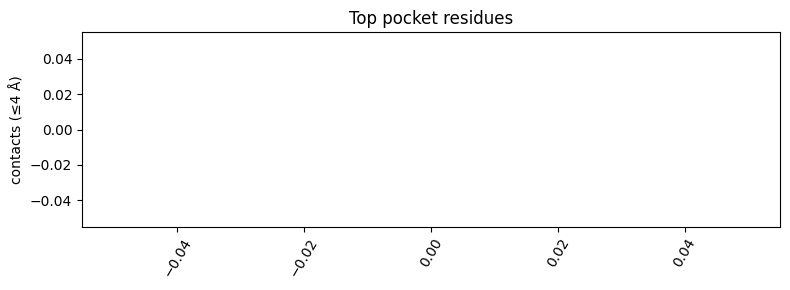

In [31]:
from Bio.PDB import PDBParser, NeighborSearch, Polypeptide
import numpy as np, matplotlib.pyplot as plt

prot='receptorH.pdb'; lig='SAH_final_out.pdb'  # or SAM
p=PDBParser(QUIET=True); sp=p.get_structure('P',prot); sl=p.get_structure('L',lig)
prot_atoms=[a for a in sp.get_atoms() if a.get_parent().id[0]==' ']
lig_atoms=[a for a in sl.get_atoms() if a.get_parent().id[0] != ' ']
ns=NeighborSearch(prot_atoms)

counts={}
for la in lig_atoms:
    for a in ns.search(la.coord,4.0):
        r=a.get_parent()
        try: aa=Polypeptide.three_to_one(r.get_resname().strip())
        except: continue
        key=f"{aa}{r.id[1]}"
        counts[key]=counts.get(key,0)+1

# plot top 15
items=sorted(counts.items(), key=lambda x:x[1], reverse=True)[:15]
labels=[k for k,_ in items]; vals=[v for _,v in items]
plt.figure(figsize=(8,3)); plt.bar(labels, vals)
plt.ylabel("contacts (≤4 Å)"); plt.xticks(rotation=60); plt.title("Top pocket residues")
plt.tight_layout(); plt.show()


In [32]:
# Contact bar chart (robust): counts protein residues within X Å of the ligand
!pip -q install biopython matplotlib

from Bio.PDB import PDBParser, NeighborSearch, Polypeptide
import numpy as np, matplotlib.pyplot as plt, os, sys

PROT = "receptorH.pdb"         # change if needed
LIG  = "SAH_final_out.pdb"     # or "SAM_final_out.pdb"
CUTOFF = 4.0                   # auto-retries at 5.0 Å if empty

assert os.path.exists(PROT), f"Missing {PROT}"
assert os.path.exists(LIG),  f"Missing {LIG}"

p = PDBParser(QUIET=True)
sp = p.get_structure('P', PROT)
sl = p.get_structure('L', LIG)

prot_atoms = [a for a in sp.get_atoms() if a.get_parent().id[0]==' ']
lig_atoms  = [a for a in sl.get_atoms() if True]   # ligand file is ligand-only; keep all

print(f"Protein atoms: {len(prot_atoms)} | Ligand atoms: {len(lig_atoms)} | Cutoff: {CUTOFF} Å")

def make_counts(cut):
    ns = NeighborSearch(prot_atoms)
    counts = {}
    hits = 0
    for la in lig_atoms:
        for a in ns.search(la.coord, cut):
            r = a.get_parent()
            try:
                aa = Polypeptide.three_to_one(r.get_resname().strip())
            except Exception:
                continue
            key = f"{aa}{r.id[1]}"
            counts[key] = counts.get(key, 0) + 1
            hits += 1
    return counts, hits

counts, hits = make_counts(CUTOFF)
if not counts:
    print("No contacts at 4.0 Å → retrying at 5.0 Å…")
    counts, hits = make_counts(5.0)

print(f"Unique contacting residues: {len(counts)} | total atom-contacts: {hits}")

if counts:
    items = sorted(counts.items(), key=lambda x: x[1], reverse=True)[:15]
    labels = [k for k,_ in items]
    vals   = [v for _,v in items]
    plt.figure(figsize=(8,3))
    plt.bar(labels, vals)
    plt.ylabel("contacts (≤ cutoff Å)")
    plt.xticks(rotation=60)
    plt.title(f"Top pocket residues vs {os.path.basename(LIG)}")
    plt.tight_layout()
    plt.show()
    print("Residues:", ", ".join(labels))
else:
    print("Still no contacts → likely a path/filename mismatch or pose far from protein. "
          "Double-check PROT/LIG names and that they’re the ones you just docked.")


Protein atoms: 5736 | Ligand atoms: 5 | Cutoff: 4.0 Å
No contacts at 4.0 Å → retrying at 5.0 Å…
Unique contacting residues: 0 | total atom-contacts: 0
Still no contacts → likely a path/filename mismatch or pose far from protein. Double-check PROT/LIG names and that they’re the ones you just docked.


In [33]:
import py3Dmol
prot='receptorH.pdb'; lig='SAH_final_out.pdb'  # or SAM
v=py3Dmol.view(width=900, height=650)
v.addModel(open(prot).read(),'pdb')
v.setStyle({'cartoon':{'color':'lightgray'}})
v.addSurface(py3Dmol.VDW, {'opacity':0.25})  # transparent skin
v.addModel(open(lig).read(),'pdb'); v.setStyle({'model':1,'stick':{}})
v.zoomTo(); v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [50]:
from Bio.PDB import PDBParser, NeighborSearch
import py3Dmol

prot='receptorH.pdb'; lig='SAH_final_out.pdb'  # or SAM
p=PDBParser(QUIET=True); sp=p.get_structure('P',prot); sl=p.get_structure('L',lig)
lig_atoms=[a for a in sl.get_atoms() if a.get_parent().id[0] != ' ']
prot_atoms=[a for a in sp.get_atoms() if a.get_parent().id[0]==' ']
ns=NeighborSearch(prot_atoms)
keep=set()
for la in lig_atoms:
    for a in ns.search(la.coord,6.0):
        r=a.get_parent(); keep.add((r.get_parent().id, r.id[1]))
# write pocket pdb
out=[]
for L in open(prot):
    if L.startswith(('ATOM','HETATM')):
        ch=L[21]; resid=int(L[22:26])
        if (ch,resid) in keep: out.append(L)
open('pocket6A.pdb','w').write(''.join(out)+'END\n')

v=py3Dmol.view(width=900, height=650)
v.addModel(open('pocket6A.pdb').read(),'pdb'); v.setStyle({'cartoon':{'color':'#e0e0e0'}})
v.addModel(open(lig).read(),'pdb'); v.setStyle({'model':1,'stick':{}})
v.zoomTo(); v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

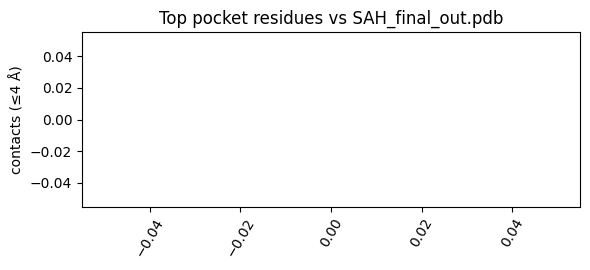

In [35]:
from Bio.PDB import PDBParser, NeighborSearch, Polypeptide
import matplotlib.pyplot as plt

PROT='receptorH.pdb'; LIG='SAH_final_out.pdb'  # or SAM
p=PDBParser(QUIET=True); sp=p.get_structure('P',PROT); sl=p.get_structure('L',LIG)
prot_atoms=[a for a in sp.get_atoms() if a.get_parent().id[0]==' ']
lig_atoms =[a for a in sl.get_atoms() if a.get_parent().id[0] != ' ']
ns=NeighborSearch(prot_atoms)

counts={}
for la in lig_atoms:
    for a in ns.search(la.coord,4.0):
        r=a.get_parent()
        try: aa=Polypeptide.three_to_one(r.get_resname().strip())
        except: continue
        key=f"{aa}{r.id[1]}"
        counts[key]=counts.get(key,0)+1

items=sorted(counts.items(), key=lambda x:x[1], reverse=True)[:10]
labels=[k for k,_ in items]; vals=[v for _,v in items]
plt.figure(figsize=(6.0,2.8)); plt.bar(labels, vals)
plt.ylabel("contacts (≤4 Å)"); plt.xticks(rotation=60); plt.title(f"Top pocket residues vs {LIG}")
plt.tight_layout(); plt.show()


In [36]:
# Color cartoon by B-factor (AlphaFold stores pLDDT in B-factor)
# Blue=low, Red=high by default pal; we add legend text
import py3Dmol

af='test_3a948_unrelaxed_rank_001_alphafold2_ptm_model_3_seed_000.pdb'  # your AF file
v=py3Dmol.view(width=900,height=650)
v.addModel(open(af).read(),'pdb')
v.setStyle({'cartoon':{'colorscheme':'bfactor'}})  # uses B-factor
v.addLabel('AF pLDDT (B-factor)', {'position':{'x':0,'y':0,'z':0}, 'backgroundOpacity':0.0})
v.zoomTo(); v.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [37]:
# overlay both and compute RMSD of adenine ring heavy atoms (rough by name pattern)
import py3Dmol, math, re

def read_atoms(pdb, sel=lambda name,elem: True):
    arr=[]
    for L in open(pdb):
        if L.startswith(('ATOM','HETATM')):
            name=L[12:16].strip(); elem=(L[76:78].strip() or name[0].upper())
            x=float(L[30:38]); y=float(L[38:46]); z=float(L[46:54])
            if sel(name, elem): arr.append((name,elem,(x,y,z)))
    return arr

# pick ring atoms by atom names commonly used on adenine (A*)
ring_names=set(['N1','C2','N3','C4','C5','C6','N7','C8','N9'])
sam = read_atoms('SAM_final_out.pdb', lambda n,e: n in ring_names)
sah = read_atoms('SAH_final_out.pdb', lambda n,e: n in ring_names)
# build dict by name, intersect
d1={n:xyz for n,_,xyz in sam}; d2={n:xyz for n,_,xyz in sah}
common=sorted(set(d1).intersection(d2))
rmsd=None
if common:
    import numpy as np
    A=np.array([d1[n] for n in common]); B=np.array([d2[n] for n in common])
    rmsd=float(np.sqrt(((A-B)**2).sum()/len(common)))

v=py3Dmol.view(width=900,height=650)
v.addModel(open('SAM_final_out.pdb').read(),'pdb'); v.setStyle({'model':0},{'stick':{}})
v.addModel(open('SAH_final_out.pdb').read(),'pdb'); v.setStyle({'model':1},{'stick':{}})
v.zoomTo(); v.show()
print("Adenine ring RMSD (Å) over", len(common), "atoms:", rmsd)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Adenine ring RMSD (Å) over 0 atoms: None


In [38]:
# Install tools
!apt-get -y update >/dev/null
!apt-get -y install apbs >/dev/null
!pip -q install pdb2pqr==3.6.1 py3Dmol biopython

import os, numpy as np
from pathlib import Path
from Bio.PDB import PDBParser

PROT = "receptorH.pdb"          # your protonated protein (no ligand)
LIG  = "SAH_final_out.pdb"      # or SAM_final_out.pdb

# 1) Make a protein-only PDB for APBS (ATOM lines only)
open("prot_only.pdb","w").write(
    "".join(L for L in open(PROT) if L.startswith(("ATOM  ","TER  "))) + "END\n"
)

# 2) Build PQR (charges/radii) at pH 7.0
!pdb2pqr30 --ff=AMBER --with-ph=7.0 prot_only.pdb prot_only.pqr

# 3) Set an APBS grid around the ligand (tight box)
p=PDBParser(QUIET=True)
lig = p.get_structure("L", LIG)
coords = np.array([a.coord for a in lig.get_atoms()])
mins, maxs = coords.min(0)-8, coords.max(0)+8  # 8 Å padding
center = coords.mean(0)

apbs_in = f"""read
  mol pqr prot_only.pqr
end
elec
  mg-auto
  dime 97 97 97
  cglen {maxs[0]-mins[0]:.2f} {maxs[1]-mins[1]:.2f} {maxs[2]-mins[2]:.2f}
  cgcent {center[0]:.2f} {center[1]:.2f} {center[2]:.2f}
  fglen {maxs[0]-mins[0]:.2f} {maxs[1]-mins[1]:.2f} {maxs[2]-mins[2]:.2f}
  fgcent {center[0]:.2f} {center[1]:.2f} {center[2]:.2f}
  lpbe
  bcfl sdh
  sdie 78.4
  pdie 2.0
  srfm smol
  chgm spl2
  sdens 10.0
  temp 298.15
  calcenergy total
  calcforce no
  mol 1
  write pot dx pot_ligbox
end
quit
"""
Path("apbs.in").write_text(apbs_in)

# 4) Run APBS to produce pot_ligbox.dx
!apbs apbs.in >/dev/null 2>&1 || echo "APBS finished (or printed above)."

# 5) Visualize: protein cartoon + surface colored by potential from .dx
import py3Dmol
assert Path("pot_ligbox.dx").exists(), "APBS .dx not created (check apbs log)."

v = py3Dmol.view(width=900, height=650)
v.addModel(open(PROT).read(),'pdb')
v.setStyle({'cartoon':{'color':'lightgray'}})
# add potential volume (OpenDX) and color the solvent surface with it
dx = open('pot_ligbox.dx').read()
vol = v.addVolumetricData(dx, 'dx', {'min':-5,'max':5})  # clamp range (kT/e)
v.addSurface(py3Dmol.VDW,
             {'opacity':0.85, 'map':vol, 'voldata':vol, 'volscheme':'rwb'}, {})  # red-white-blue
# add ligand
v.addModel(open(LIG).read(),'pdb'); v.setStyle({'model':1,'stick':{}})
v.zoomTo(); v.show()


W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 208.2/208.2 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 575.5/575.5 kB 31.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.1/104.1 kB 8.1 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sphinx 8.2.3 requires docutils<0.22,>=0.20, but you have docutils 0.17.1 which is incompatible.
INFO:PDB2PQR v3.6.1: biomolecular structure conversion software.
INFO:Please cite:  Jurrus E, et al.  Improvements to the APBS biomolecular solvation software suite.  Protein Sci 27 112-128 (2018).
INFO:Please cite:  Dolinsky TJ, et al.  PDB2PQR: expanding and upgrading automated preparation of bio

AssertionError: APBS .dx not created (check apbs log).

In [39]:
# Split multi-model PDBQT into separate ligand PDBs and overlay
import os, re, py3Dmol, tempfile, pathlib, subprocess

TAG   = "SAM"                     # or "SAH"
PDBQT = f"{TAG}_final_out.pdbqt"  # should contain multiple MODELs (num_modes>=10)

assert os.path.exists(PDBQT), "Run final docking first to create *_final_out.pdbqt"

poses=[]
cur=None
for line in open(PDBQT):
    if line.startswith("MODEL"):
        cur=[]
    elif line.startswith("ENDMDL"):
        poses.append("".join(cur))
    else:
        cur.append(line)
# Keep top 10 poses
poses = poses[:10]; print(f"Found {len(poses)} poses")

v = py3Dmol.view(width=900, height=650)
for i,p in enumerate(poses):
    pdbqt_path = f"_pose_{i+1}.pdbqt"
    open(pdbqt_path,"w").write(p)
    # convert each pose to PDB (with hydrogens)
    pdb_path = f"_pose_{i+1}.pdb"
    subprocess.run(["obabel","-ipdbqt",pdbqt_path,"-opdb","-O",pdb_path,"-h"], check=True)
    v.addModel(open(pdb_path).read(),'pdb')
    # fade later poses
    v.setStyle({'model':i},{'stick':{'opacity': max(0.25, 1.0 - i*0.08)}})

# add faint protein
v.addModel(open("receptorH.pdb").read(),'pdb')
v.setStyle({'model':len(poses)},{'cartoon':{'opacity':0.15, 'color':'lightgray'}})
v.zoomTo(); v.show()


Found 10 poses


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [40]:
# Split multi-model PDBQT into separate ligand PDBs and overlay
import os, re, py3Dmol, tempfile, pathlib, subprocess

TAG   = "SAH"                     # or "SAH"
PDBQT = f"{TAG}_final_out.pdbqt"  # should contain multiple MODELs (num_modes>=10)

assert os.path.exists(PDBQT), "Run final docking first to create *_final_out.pdbqt"

poses=[]
cur=None
for line in open(PDBQT):
    if line.startswith("MODEL"):
        cur=[]
    elif line.startswith("ENDMDL"):
        poses.append("".join(cur))
    else:
        cur.append(line)
# Keep top 10 poses
poses = poses[:10]; print(f"Found {len(poses)} poses")

v = py3Dmol.view(width=900, height=650)
for i,p in enumerate(poses):
    pdbqt_path = f"_pose_{i+1}.pdbqt"
    open(pdbqt_path,"w").write(p)
    # convert each pose to PDB (with hydrogens)
    pdb_path = f"_pose_{i+1}.pdb"
    subprocess.run(["obabel","-ipdbqt",pdbqt_path,"-opdb","-O",pdb_path,"-h"], check=True)
    v.addModel(open(pdb_path).read(),'pdb')
    # fade later poses
    v.setStyle({'model':i},{'stick':{'opacity': max(0.25, 1.0 - i*0.08)}})

# add faint protein
v.addModel(open("receptorH.pdb").read(),'pdb')
v.setStyle({'model':len(poses)},{'cartoon':{'opacity':0.15, 'color':'lightgray'}})
v.zoomTo(); v.show()


Found 10 poses


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [42]:
# Color all residues within 4.5 Å of ligand; label top contacts
from Bio.PDB import PDBParser, NeighborSearch, Polypeptide
import py3Dmol, collections

PROT='receptorH.pdb'; LIG='SAH_final_out.pdb'   # or SAM
p=PDBParser(QUIET=True); sp=p.get_structure('P',PROT); sl=p.get_structure('L',LIG)
prot_atoms=[a for a in sp.get_atoms() if a.get_parent().id[0]==' ']
lig_atoms =[a for a in sl.get_atoms() if a.get_parent().id[0] != ' ']
ns=NeighborSearch(prot_atoms)

counts = collections.Counter()
resinfo = {}  # key -> (chain,resid,three_letter)
for la in lig_atoms:
    for a in ns.search(la.coord,4.5):
        r=a.get_parent(); ch=r.get_parent().id; resid=r.id[1]; three=r.get_resname().strip()
        key=f"{Polypeptide.three_to_one(three)}{resid}"
        counts[key]+=1; resinfo[key]=(ch,resid,three)

top = [k for k,_ in counts.most_common(8)]
print("Top contact residues:", ", ".join(top))

v=py3Dmol.view(width=900, height=650)
v.addModel(open(PROT).read(),'pdb')

# default protein light
v.setStyle({'cartoon':{'color':'#e0e0e0'}})

# color contact shell
for k in counts:
    ch,resid,three = resinfo[k]
    v.setStyle({'and':[{'chain':ch},{'resi':int(resid)}]},
               {'cartoon':{'color':'#90caf9'}})   # sky blue

# highlight top contacts brighter, add labels
for k in top:
    ch,resid,three=resinfo[k]
    v.setStyle({'and':[{'chain':ch},{'resi':int(resid)}]},
               {'cartoon':{'color':'#42a5f5'}})   # brighter blue
    v.addLabel(f"{three}{resid}",
               {'backgroundOpacity':0.6,
                'fontSize':12,
                'position':'atom',
                'anchor':{'chain':ch,'resi':int(resid)} })

# ligand as sticks
v.addModel(open(LIG).read(),'pdb'); v.setStyle({'model':1,'stick':{}})
v.zoomTo(); v.show()


Top contact residues: 


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

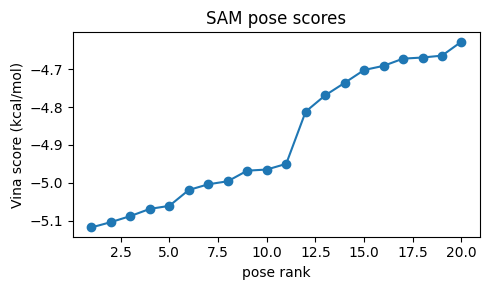

Top score: -5.118


In [43]:
import re, matplotlib.pyplot as plt, os
TAG="SAM"   # or "SAH"
pq=f"{TAG}_final_out.pdbqt"; assert os.path.exists(pq)
scores=[]
for line in open(pq):
    m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
    if m: scores.append(float(m.group(1)))
plt.figure(figsize=(5,3))
plt.plot(range(1,len(scores)+1), scores, marker='o')
plt.xlabel("pose rank"); plt.ylabel("Vina score (kcal/mol)")
plt.title(f"{TAG} pose scores"); plt.tight_layout(); plt.show()
print("Top score:", scores[0] if scores else None)


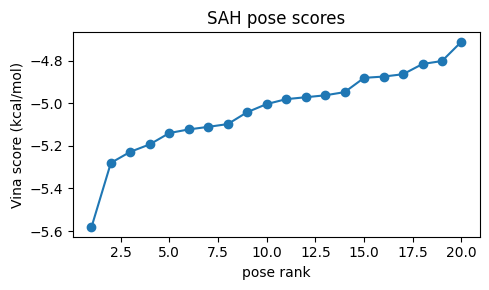

Top score: -5.583


In [51]:
import re, matplotlib.pyplot as plt, os
TAG="SAH"   # or "SAH"
pq=f"{TAG}_final_out.pdbqt"; assert os.path.exists(pq)
scores=[]
for line in open(pq):
    m=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", line)
    if m: scores.append(float(m.group(1)))
plt.figure(figsize=(5,3))
plt.plot(range(1,len(scores)+1), scores, marker='o')
plt.xlabel("pose rank"); plt.ylabel("Vina score (kcal/mol)")
plt.title(f"{TAG} pose scores"); plt.tight_layout(); plt.show()
print("Top score:", scores[0] if scores else None)


In [44]:
import py3Dmol, os, re, subprocess, numpy as np

def show_pose_cloud(tag="SAM", n=10, prot="receptorH.pdb"):
    pq=f"{tag}_final_out.pdbqt"; assert os.path.exists(pq)
    models=[]; block=[]
    for line in open(pq):
        if line.startswith("MODEL"): block=[]
        elif line.startswith("ENDMDL"): models.append("".join(block))
        else: block.append(line)
    models=models[:n]
    v=py3Dmol.view(width=900,height=650)
    cents=[]
    for i,mdl in enumerate(models):
        tmpq=f"_{tag}_pose_{i+1}.pdbqt"; open(tmpq,"w").write(mdl)
        tmpp=f"_{tag}_pose_{i+1}.pdb"
        subprocess.run(["obabel","-ipdbqt",tmpq,"-opdb","-O",tmpp,"-h"], check=True)
        v.addModel(open(tmpp).read(),'pdb')
        v.setStyle({'model':i},{'stick':{'opacity':max(0.25,1.0-i*0.08)}})
        # centroid
        coords=[]
        for L in open(tmpp):
            if L.startswith(("ATOM","HETATM")):
                x=float(L[30:38]);y=float(L[38:46]);z=float(L[46:54]); coords.append((x,y,z))
        if coords: cents.append(np.array(coords).mean(0))
    if os.path.exists(prot):
        v.addModel(open(prot).read(),'pdb'); v.setStyle({'model':len(models)},{'cartoon':{'opacity':0.15}})
    # connect centroids
    for i in range(len(cents)-1):
        a=cents[i]; b=cents[i+1]
        v.addLine({'start':{'x':float(a[0]),'y':float(a[1]),'z':float(a[2])},
                   'end'  :{'x':float(b[0]),'y':float(b[1]),'z':float(b[2])}},
                  {'dashed':True})
    v.zoomTo(); v.show()

show_pose_cloud("SAM", n=10)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

/tmp/ipython-input-2119238578.py:50: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(mat, aspect='auto', interpolation='nearest')


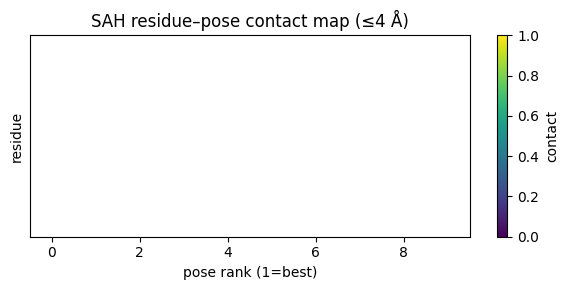

In [45]:
from Bio.PDB import PDBParser, NeighborSearch, Polypeptide
import numpy as np, matplotlib.pyplot as plt, os, re, subprocess

PROT="receptorH.pdb"; TAG="SAH"; pq=f"{TAG}_final_out.pdbqt"
assert os.path.exists(PROT) and os.path.exists(pq)

# split poses to PDBs
poses=[]
blk=[];
for line in open(pq):
    if line.startswith("MODEL"): blk=[]
    elif line.startswith("ENDMDL"): poses.append("".join(blk))
    else: blk.append(line)
N=min(10,len(poses))
pdbs=[]
for i in range(N):
    tmpq=f"_{TAG}_pose_{i+1}.pdbqt"; open(tmpq,"w").write(poses[i])
    tmpp=f"_{TAG}_pose_{i+1}.pdb"
    subprocess.run(["obabel","-ipdbqt",tmpq,"-opdb","-O",tmpp,"-h"], check=True)
    pdbs.append(tmpp)

p=PDBParser(QUIET=True); sp=p.get_structure('P',PROT)
prot_atoms=[a for a in sp.get_atoms() if a.get_parent().id[0]==' ']
res_keys=[]
for r in sp.get_residues():
    if r.id[0]==' ':
        try: k=f"{Polypeptide.three_to_one(r.get_resname().strip())}{r.id[1]}"
        except: continue
        res_keys.append(k)
res_keys=sorted(set(res_keys), key=lambda s:(s[-3:].isdigit(), s))
idx={k:i for i,k in enumerate(res_keys)}
mat=np.zeros((len(res_keys), N), dtype=int)

for j,ligpdb in enumerate(pdbs):
    sl=p.get_structure('L', ligpdb)
    lig_atoms=[a for a in sl.get_atoms() if a.get_parent().id[0] != ' ']
    ns=NeighborSearch(prot_atoms)
    hits=set()
    for la in lig_atoms:
        for a in ns.search(la.coord,4.0):
            r=a.get_parent()
            if r.id[0]!=' ':
                try: k=f"{Polypeptide.three_to_one(r.get_resname().strip())}{r.id[1]}"
                except: continue
                hits.add(k)
    for k in hits:
        if k in idx: mat[idx[k], j]=1

plt.figure(figsize=(6, max(3, len(res_keys)*0.12)))
plt.imshow(mat, aspect='auto', interpolation='nearest')
plt.xlabel("pose rank (1=best)"); plt.ylabel("residue")
plt.yticks(range(len(res_keys)), res_keys, fontsize=7)
plt.title(f"{TAG} residue–pose contact map (≤4 Å)")
plt.colorbar(label="contact"); plt.tight_layout(); plt.show()


In [46]:
import glob, re, numpy as np, matplotlib.pyplot as plt, os

def load_centers(prefix, tag):
    pts=[]; scs=[]
    for f in glob.glob(f"{prefix}_{tag}_*.pdbqt"):
        m=re.search(rf"{prefix}_{tag}_([-\d\.]+)_([-\d\.]+)_([-\d\.]+)\.pdbqt", f)
        if not m: continue
        x,y,z=map(float, m.groups())
        score=None
        for L in open(f):
            mm=re.search(r"REMARK VINA RESULT:\s+(-?\d+\.\d+)", L)
            if mm: score=float(mm.group(1)); break
        if score is not None: pts.append((x,y,z)); scs.append(score)
    return np.array(pts), np.array(scs)

pts,sc = load_centers("lite","SAM")  # or "coarse"/"SAH"
if len(pts)==0: print("No scan files found.")
else:
    plt.figure(figsize=(5,4))
    plt.scatter(pts[:,0], pts[:,1], c=sc, s=80)
    plt.gca().set_aspect('equal', 'box')
    plt.colorbar(label='Vina score (kcal/mol)')
    plt.xlabel('X'); plt.ylabel('Y'); plt.title('Scan landscape (Z collapsed)')
    plt.tight_layout(); plt.show()


No scan files found.


In [47]:
from Bio.PDB import PDBParser, NeighborSearch, Polypeptide
import matplotlib.pyplot as plt

PROT='receptorH.pdb'; LIG='SAH_final_out.pdb'
hydro=set("AVLIMFWYPG")
p=PDBParser(QUIET=True); sp=p.get_structure('P',PROT); sl=p.get_structure('L',LIG)
prot_atoms=[a for a in sp.get_atoms() if a.get_parent().id[0]==' ']
lig_atoms =[a for a in sl.get_atoms() if a.get_parent().id[0] != ' ']
ns=NeighborSearch(prot_atoms)

counts={'hydrophobic':0,'polar/charged':0}
seen=set()
for la in lig_atoms:
    for a in ns.search(la.coord,4.0):
        r=a.get_parent()
        if r.id[0]!=' ':
            try: aa=Polypeptide.three_to_one(r.get_resname().strip())
            except: continue
            key=(aa,r.id[1])
            if key in seen: continue
            seen.add(key)
            counts['hydrophobic' if aa in hydro else 'polar/charged']+=1

plt.figure(figsize=(4,4))
plt.pie([counts['hydrophobic'], counts['polar/charged']],
        labels=['hydrophobic','polar/charged'], autopct='%1.0f%%', startangle=90)
plt.title(f"Contact types vs {LIG}")
plt.tight_layout(); plt.show()
print(counts)


/usr/local/lib/python3.12/dist-packages/matplotlib/axes/_axes.py:3343: RuntimeWarning: invalid value encountered in divide
  x = x / sx


ValueError: cannot convert float NaN to integer

ValueError: need at least one array to concatenate

<Figure size 400x400 with 1 Axes>

# Instructions <a name="Instructions"></a>
For detailed instructions, tips and tricks, see recently published paper at [Nature Protocols](https://www.nature.com/articles/s41596-024-01060-5)

**Quick start**
1. Paste your protein sequence(s) in the input field.
2. Press "Runtime" -> "Run all".
3. The pipeline consists of 5 steps. The currently running step is indicated by a circle with a stop sign next to it.

**Result zip file contents**

1. PDB formatted structures sorted by avg. pLDDT and complexes are sorted by pTMscore. (unrelaxed and relaxed if `use_amber` is enabled).
2. Plots of the model quality.
3. Plots of the MSA coverage.
4. Parameter log file.
5. A3M formatted input MSA.
6. A `predicted_aligned_error_v1.json` using [AlphaFold-DB's format](https://alphafold.ebi.ac.uk/faq#faq-7) and a `scores.json` for each model which contains an array (list of lists) for PAE, a list with the average pLDDT and the pTMscore.
7. BibTeX file with citations for all used tools and databases.

At the end of the job a download modal box will pop up with a `jobname.result.zip` file. Additionally, if the `save_to_google_drive` option was selected, the `jobname.result.zip` will be uploaded to your Google Drive.

**MSA generation for complexes**

For the complex prediction we use unpaired and paired MSAs. Unpaired MSA is generated the same way as for the protein structures prediction by searching the UniRef100 and environmental sequences three iterations each.

The paired MSA is generated by searching the UniRef100 database and pairing the best hits sharing the same NCBI taxonomic identifier (=species or sub-species). We only pair sequences if all of the query sequences are present for the respective taxonomic identifier.

**Using a custom MSA as input**

To predict the structure with a custom MSA (A3M formatted): (1) Change the `msa_mode`: to "custom", (2) Wait for an upload box to appear at the end of the "MSA options ..." box. Upload your A3M. The first fasta entry of the A3M must be the query sequence without gaps.

It is also possilbe to provide custom MSAs for complex predictions. Read more about the format [here](https://github.com/sokrypton/ColabFold/issues/76).

As an alternative for MSA generation the [HHblits Toolkit server](https://toolkit.tuebingen.mpg.de/tools/hhblits) can be used. After submitting your query, click "Query Template MSA" -> "Download Full A3M". Download the A3M file and upload it in this notebook.

**PDB100** <a name="pdb100"></a>

As of 23/06/08, we have transitioned from using the PDB70 to a 100% clustered PDB, the PDB100. The construction methodology of PDB100 differs from that of PDB70.

The PDB70 was constructed by running each PDB70 representative sequence through [HHblits](https://github.com/soedinglab/hh-suite) against the [Uniclust30](https://uniclust.mmseqs.com/). On the other hand, the PDB100 is built by searching each PDB100 representative structure with [Foldseek](https://github.com/steineggerlab/foldseek) against the [AlphaFold Database](https://alphafold.ebi.ac.uk).

To maintain compatibility with older Notebook versions and local installations, the generated files and API responses will continue to be named "PDB70", even though we're now using the PDB100.

**Using custom templates** <a name="custom_templates"></a>

To predict the structure with a custom template (PDB or mmCIF formatted): (1) change the `template_mode` to "custom" in the execute cell and (2) wait for an upload box to appear at the end of the "Input Protein" box. Select and upload your templates (multiple choices are possible).

* Templates must follow the four letter PDB naming with lower case letters.

* Templates in mmCIF format must contain `_entity_poly_seq`. An error is thrown if this field is not present. The field `_pdbx_audit_revision_history.revision_date` is automatically generated if it is not present.

* Templates in PDB format are automatically converted to the mmCIF format. `_entity_poly_seq` and `_pdbx_audit_revision_history.revision_date` are automatically generated.

If you encounter problems, please report them to this [issue](https://github.com/sokrypton/ColabFold/issues/177).

**Comparison to the full AlphaFold2 and AlphaFold2 Colab**

This notebook replaces the homology detection and MSA pairing of AlphaFold2 with MMseqs2. For a comparison against the [AlphaFold2 Colab](https://colab.research.google.com/github/deepmind/alphafold/blob/main/notebooks/AlphaFold.ipynb) and the full [AlphaFold2](https://github.com/deepmind/alphafold) system read our [paper](https://www.nature.com/articles/s41592-022-01488-1).

**Troubleshooting**
* Check that the runtime type is set to GPU at "Runtime" -> "Change runtime type".
* Try to restart the session "Runtime" -> "Factory reset runtime".
* Check your input sequence.

**Known issues**
* Google Colab assigns different types of GPUs with varying amount of memory. Some might not have enough memory to predict the structure for a long sequence.
* Your browser can block the pop-up for downloading the result file. You can choose the `save_to_google_drive` option to upload to Google Drive instead or manually download the result file: Click on the little folder icon to the left, navigate to file: `jobname.result.zip`, right-click and select \"Download\" (see [screenshot](https://pbs.twimg.com/media/E6wRW2lWUAEOuoe?format=jpg&name=small)).

**Limitations**
* Computing resources: Our MMseqs2 API can handle ~20-50k requests per day.
* MSAs: MMseqs2 is very precise and sensitive but might find less hits compared to HHblits/HMMer searched against BFD or MGnify.
* We recommend to additionally use the full [AlphaFold2 pipeline](https://github.com/deepmind/alphafold).

**Description of the plots**
*   **Number of sequences per position** - We want to see at least 30 sequences per position, for best performance, ideally 100 sequences.
*   **Predicted lDDT per position** - model confidence (out of 100) at each position. The higher the better.
*   **Predicted Alignment Error** - For homooligomers, this could be a useful metric to assess how confident the model is about the interface. The lower the better.

**Bugs**
- If you encounter any bugs, please report the issue to https://github.com/sokrypton/ColabFold/issues

**License**

The source code of ColabFold is licensed under [MIT](https://raw.githubusercontent.com/sokrypton/ColabFold/main/LICENSE). Additionally, this notebook uses the AlphaFold2 source code and its parameters licensed under [Apache 2.0](https://raw.githubusercontent.com/deepmind/alphafold/main/LICENSE) and [CC BY 4.0](https://creativecommons.org/licenses/by-sa/4.0/) respectively. Read more about the AlphaFold license [here](https://github.com/deepmind/alphafold).

**Acknowledgments**
- We thank the AlphaFold team for developing an excellent model and open sourcing the software.

- [KOBIC](https://kobic.re.kr) and [Söding Lab](https://www.mpinat.mpg.de/soeding) for providing the computational resources for the MMseqs2 MSA server.

- Richard Evans for helping to benchmark the ColabFold's Alphafold-multimer support.

- [David Koes](https://github.com/dkoes) for his awesome [py3Dmol](https://3dmol.csb.pitt.edu/) plugin, without whom these notebooks would be quite boring!

- Do-Yoon Kim for creating the ColabFold logo.

- A colab by Sergey Ovchinnikov ([@sokrypton](https://twitter.com/sokrypton)), Milot Mirdita ([@milot_mirdita](https://twitter.com/milot_mirdita)) and Martin Steinegger ([@thesteinegger](https://twitter.com/thesteinegger)).
